# Data Exploration

In [1]:
import pickle
import pandas as pd
import numpy as np

In [2]:
import pandas as pd
import datetime as dt
import numpy as np

import pandas as pd
import datetime as dt
import numpy as np

class TrainDataProcessor:
    """Processes Train data, using train data as a warm start, and prepares it for inference."""

    def __init__(self, train, revealed_targets, client, historical_weather,
                 forecast_weather, electricity_prices, gas_prices):
        self.test_orig_dfs = self.get_test_orig_dfs([train.copy(), revealed_targets.copy(), client.copy(), historical_weather.copy(),
                 forecast_weather.copy(), electricity_prices.copy(), gas_prices.copy()])
        self.train = self.init_train(train)
        self.revealed_targets = self.init_revealed_targets(revealed_targets)
        self.client = self.init_client(client)
        self.weather_mapping = self.init_weather_mapping()
        self.historical_weather = self.init_historical_weather(historical_weather)
        self.forecast_weather = self.init_forecast_weather(forecast_weather)
        self.electricity_prices = self.init_electricity(electricity_prices)
        self.gas_prices = self.init_gas_prices(gas_prices)
        
        self.df_all_cols = self.join_data(self.train, self.revealed_targets, self.client, self.historical_weather, self.forecast_weather, self.electricity_prices, self.gas_prices)
        self.df = self.remove_cols(self.df_all_cols)
        
    def get_test_orig_dfs(self, dfs):
        for i, df in enumerate(dfs):
            if 'datetime' in df.columns:
                df['datetime'] = pd.to_datetime(df.datetime)
                col = 'datetime'
            if 'prediction_datetime' in df.columns:
                df['prediction_datetime'] = pd.to_datetime(df.prediction_datetime)
                col = 'prediction_datetime'
            if 'forecast_date' in df.columns:
                df['forecast_date'] = pd.to_datetime(df['forecast_date'])
                col = 'forecast_date'
            if 'forecast_datetime' in df.columns:
                df['forecast_datetime'] = pd.to_datetime(df['forecast_datetime'])
                col = 'forecast_datetime'
            if 'date' in df.columns:
                df['date'] = pd.to_datetime(df.date).dt.date
                col = 'date'

            test_date = df[col].iloc[-1]  # Assuming test is a DataFrame
            start_date = test_date - pd.Timedelta(days=14)
            historical_subset = df[df[col] >= start_date]
            dfs[i] = historical_subset
        return dfs
        
    def init_train(self, df):
        """Prepares the training data for model training."""
        try:
            df['datetime'] = pd.to_datetime(df.datetime)
        except Exception as e:
            df['datetime'] = pd.to_datetime(df.prediction_datetime)
        df['date'] = df.datetime.dt.date
            
        # df = self.get_data_block_id(df, 'datetime')
        return df
    
    def add_electricity_lag_features(self, df):
        """Chatgpt summary:
        Enhances a DataFrame with electricity price lag features:
        - Sets 'datetime' as Index for time series analysis.
        - Calculates rolling 7-day mean price, lagged by one day.
        - Computes rolling 7-day mean for same hour, lagged.
        - Adds column for yesterday's price, shifted by 24 hours.
        - Calculates 24-hour rolling average of electricity prices.
        - Resets index and drops 'forecast_date', 'origin_date', 'hour'.
        """
        ##### mean from entire last week
        df.set_index('datetime', inplace=True)
        # Use rolling to calculate mean price of the last week
        # The window is 7 days, min_periods can be set as per requirement
        # 'closed' determines which side of the interval is closed; it can be 'right' or 'left'
        df['mean_euros_per_mwh_last_week'] = df['euros_per_mwh'].rolling(window='7D', min_periods=1, closed='right').mean()
        # Shift the results to align with the requirement of lagging
        df['mean_euros_per_mwh_last_week'] = df['mean_euros_per_mwh_last_week'].shift()
        
        ##### mean from last week this hour only
        # Extract hour from datetime
        df['hour'] = df.index.hour

        # Group by hour and apply rolling mean for each group
        hourly_groups = df.groupby('hour')
        dff = hourly_groups['euros_per_mwh'].rolling(window='7D', min_periods=1, closed='right').mean()#.shift()#.reset_index(level=0, drop=True)
        dff = dff.reset_index().set_index('datetime').groupby('hour')['euros_per_mwh'].shift()
        dff = dff.rename('mean_euros_per_mwh_same_hour_last_week')
        df = df.join(dff)
        #### yesterday's power price
        df['yesterdays_euros_per_mwh'] = df['euros_per_mwh'].shift(24)
        
        ### 24h average
        # Calculate the 24-hour rolling average
        df['euros_per_mwh_24h_average_price'] = df['euros_per_mwh'].rolling(window=24, min_periods=1).mean()

        # Resetting the index if needed
        df.reset_index(inplace=True)
        df = df.drop(['forecast_date', 'origin_date', 'hour'], axis=1)
        return df

    def init_electricity(self, df):
        ## LAG = 1 Day
        ## Move forecast datetime ahead by 1 day
        ## change name to datetime
        df['datetime'] = pd.to_datetime(df['forecast_date'])
        df['datetime'] = df['datetime'] + dt.timedelta(days=1)
        # df = self.get_data_block_id(df, 'datetime')
        df = self.add_electricity_lag_features(df)
        return df
    
    def add_historical_weather_lag_features(self, df):
        """Chatgpt summary:
        Enhances a DataFrame with historical weather lag features:
        - Converts 'datetime' to Datetime object and sets as index.
        - Sorts data by 'datetime', 'latitude', 'longitude'.
        - Creates 'location_id' as a unique identifier for each location.
        - Filters for 10:00 AM entries and shifts features by 1 day.
        - Merges lagged features with original DataFrame.
        - Calculates mean and variance for weather features over the last 24 hours.
        - Merges these statistical summaries back into the original DataFrame.
        """
        ##### LATEST WEATHER
        def add_latest_weather(df):
            # Assuming df is your original DataFrame
            # Step 1: Convert datetime to a Datetime Object
            df['datetime'] = pd.to_datetime(df['datetime'])
            df.set_index('datetime', inplace=True)

            # Step 2: Sorting the Data
            df.sort_values(by=['datetime', 'latitude', 'longitude'], inplace=True)

            # Step 3: Creating a Unique Identifier for each location
            df['location_id'] = df['latitude'].astype(str) + '_' + df['longitude'].astype(str)

            # Step 4: Filtering for 10:00 AM Entries
            df.reset_index(inplace=True)
            df_10am = df[df['datetime'].dt.hour == 10]
            df_10am.set_index('datetime', inplace=True)

            # Step 5: Shifting the Features by 1 day
            lagged_features = df_10am.groupby('location_id').shift(periods=1, freq='D')

            # Renaming columns to indicate lag
            lagged_features = lagged_features.add_suffix('_hw_lagged')
            lagged_features['location_id'] = lagged_features['location_id_hw_lagged']
            lagged_features.reset_index(inplace=True)
            lagged_features['date'] = lagged_features.datetime.dt.date

            df['date'] = df.datetime.dt.date
            return lagged_features
            # Step 6: Merging Lagged Features with Original DataFrame
            df = df.merge(lagged_features, on=['date', 'location_id'], how='left', suffixes=('', '_hw_lagged'))
            return df
        
        ##### mean from last day
        def add_24h_mean_var(df, weather_features):
            # Calculate the start and end times for each row
            df['start_time'] = pd.to_datetime(df['datetime'].dt.date) - pd.Timedelta(days=2) + pd.Timedelta(hours=11)
            df['end_time'] = pd.to_datetime(df['datetime'].dt.date) - pd.Timedelta(days=1) + pd.Timedelta(hours=10)
            df['time_code'] = df['start_time'].astype(str) +'_' + df['end_time'].astype(str) + '_' + df['latitude'].astype(str) + '_' + df['longitude'].astype(str)
            # print(df.time_code)

            # Create a helper column for grouping
            # If the time is before 10:00 AM, subtract a day
            df['group'] = df['datetime'].apply(lambda dt: dt if dt.time() >= pd.to_datetime('11:00').time() else dt - pd.Timedelta(days=1))
            df['group'] = df['group'].dt.date  # Keep only the date part for grouping
            df['group'] = (pd.to_datetime(df['group']) + pd.Timedelta(hours=11)).astype(str) + '_' + (pd.to_datetime(df['group']) + pd.Timedelta(days=1, hours=10)).astype(str) + '_' + df['latitude'].astype(str) + '_' + df['longitude'].astype(str)

            # Now group by this new column
            grouped = df.groupby('group')
            means = grouped[weather_features].mean()
            variances = grouped[weather_features].var()

            # Merge means and variances into the original DataFrame
            my_df = df.merge(means, left_on='time_code', right_on='group', suffixes=('', '_hw_means'), how='left')
            my_df = my_df.merge(variances, left_on='time_code', right_on='group', how='left', suffixes=('', '_hw_variances'))

            return my_df

        df['datetime'] = pd.to_datetime(df['datetime'])
        weather_features = df.columns.drop(['datetime', 'latitude', 'longitude'])

        # Apply the function
        df = add_24h_mean_var(df, weather_features)       
        latest = add_latest_weather(df)
        df = df.merge(latest, on=['date', 'location_id'], how='left', suffixes=('', '_hw_lagged'))
        
        return df

    def init_historical_weather(self, df):
        ## LAG: From 11:00 AM 2 days ago to 10:00 AM 1 day ago
        ## What to do? Give most recent weather forecast? Give average over the last day?
        """
        Processes the historical weather data.
        """
        df['datetime'] = pd.to_datetime(df.datetime)
        
        df = self.add_historical_weather_lag_features(df)
        
        df = df.merge(self.weather_mapping, how='inner', on=('latitude', 'longitude'))
        return df

    def init_forecast_weather(self, df):
        """Chatgpt summary:
        Processes forecast weather data:
        - Converts 'forecast_datetime' to 'datetime' and adjusts it forward by 1 day.
        - Filters data to keep records with 'hours_ahead' between 22 and 45.
        - Merges with a weather mapping based on 'latitude' and 'longitude'.
        """
        ## LAG: DON't ADJUST
        ##      The forecast is from yesterday, but can forecast today, which is 22 hours ahead
        ## Drop any columns where:
        ##                        hours_ahead < 22 and hours_ahead > 45
        ## Then rename forecast_datetime to datetime and join on datetime
        """
        Processes the forecast weather data.
        """
        df['datetime'] = pd.to_datetime(df['forecast_datetime'])
        # keep only datetimes from our relevant period
        df = df[(df['hours_ahead'] < 46) & (df['hours_ahead'] > 21)]
        df['datetime'] = df['datetime'] + dt.timedelta(days=1)
        df = df.merge(self.weather_mapping, how='inner', on=('latitude', 'longitude'))
        return df
    
    def add_gas_prices_lag_features(self, df):
        """Chatgpt summary
        Augments a DataFrame with rolling average lag features for gas prices:
        - Converts 'date' to Datetime object and sets as index.
        - Sorts DataFrame by date.
        - Calculates rolling averages for lowest and highest gas prices over 3, 7, and 14 days.
        - Resets the index to include 'date' as a column again.
        """
        df['date'] = pd.to_datetime(df['date'])
        df.set_index('date', inplace=True)

        # Sort the DataFrame by date, if it's not already sorted
        df.sort_index(inplace=True)

        # Calculate rolling averages for different time windows
        df['lowest_price_3d_avg'] = df['lowest_price_per_mwh'].rolling(window=3).mean()
        df['highest_price_3d_avg'] = df['highest_price_per_mwh'].rolling(window=3).mean()

        df['lowest_price_7d_avg'] = df['lowest_price_per_mwh'].rolling(window=7).mean()
        df['highest_price_7d_avg'] = df['highest_price_per_mwh'].rolling(window=7).mean()

        df['lowest_price_14d_avg'] = df['lowest_price_per_mwh'].rolling(window=14).mean()
        df['highest_price_14d_avg'] = df['highest_price_per_mwh'].rolling(window=14).mean()

        # Reset the index if you want the 'date' column back
        df.reset_index(inplace=True)
        return df

    def init_gas_prices(self, df):
        ## LAG: 1 DAY
        ## Predictions are made from 2 days ago and predict for yesterday
        ## add one day to forecast_date
        ## Rename forecast_date to date, join on date
        """
        Processes the gas prices data.
        Implement the logic to handle gas prices data processing here.
        """
        df['date'] = pd.to_datetime(df['forecast_date']).dt.date
        df['date'] = df['date'] + dt.timedelta(days=1)
        df = self.add_gas_prices_lag_features(df)
        return df
    
    def add_revealed_target_features(self, df):
        """Chatgpt summary:
        Enhances DataFrame with rolling average target features:
        - Converts 'datetime' to Datetime object, extracts 'hour' and 'day' of week.
        - Sets 'datetime' as index.
        - Calculates various rolling averages of 'target' based on different groupings:
          - 24-hour rolling average by county, business status, product type, and consumption status.
          - 7-day hourly rolling average by county, business status, product type, consumption status, and hour.
          - 4-week rolling average by county, business status, product type, consumption status, hour, and day.
          - Similar calculations considering all product types.
        - Drops 'hour' and 'day' columns after processing.
        """
        df['datetime'] = pd.to_datetime(df['datetime'])
        df['hour'] = df.datetime.dt.hour
        df['day'] = df.datetime.dt.dayofweek
        df.set_index('datetime', inplace=True)

        window_size = 7
        # Group by the specified columns and then apply the rolling mean
        grouped = df.groupby(['county', 'is_business', 'product_type', 'is_consumption'])
        df['target_rolling_avg_24h'] = grouped['target'].transform(lambda x: x.rolling(window=24, min_periods=1).mean())

        grouped = df.groupby(['county', 'is_business', 'product_type', 'is_consumption', 'hour'])
        df['target_rolling_avg_hour_7d'] = grouped['target'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())

        grouped = df.groupby(['county', 'is_business', 'product_type', 'is_consumption', 'hour', 'day'])
        df['target_rolling_avg_hour_hour_day_4w'] = grouped['target'].transform(lambda x: x.rolling(window=4, min_periods=1).mean())

        grouped = df.groupby(['county', 'is_business', 'is_consumption'])
        df['target_rolling_allp_avg_24h'] = grouped['target'].transform(lambda x: x.rolling(window=24, min_periods=1).mean())

        grouped = df.groupby(['county', 'is_business', 'is_consumption', 'hour'])
        df['target_rolling_allp_avg_hour_7d'] = grouped['target'].transform(lambda x: x.rolling(window=7, min_periods=1).mean())

        grouped = df.groupby(['county', 'is_business', 'is_consumption', 'hour', 'day'])
        df['target_rolling_allp_avg_hour_hour_day_4w'] = grouped['target'].transform(lambda x: x.rolling(window=4, min_periods=1).mean())
        
        df = df.drop(['hour', 'day'], axis=1)

        return df
    
    def init_revealed_targets(self, df):
        df['datetime'] = pd.to_datetime(df.datetime)
        df['datetime'] = df['datetime'] + dt.timedelta(days=2)
        df = self.add_revealed_target_features(df)
        return df
    
    def init_client(self, df):
        ## LAG: 2 days
        ## Add 2 days to date, join on date
        df['date'] = pd.to_datetime(df.date).dt.date
        df['date'] = df['date'] + dt.timedelta(days=2)
        # df = self.get_data_block_id(df, 'date')
        return df

    def init_weather_mapping(self):
        # https://www.kaggle.com/code/tsunotsuno/enefit-eda-baseline/notebook#Baseline
        county_point_map = {
            0: (59.4, 24.7), # "HARJUMAA"
            1 : (58.8, 22.7), # "HIIUMAA"
            2 : (59.1, 27.2), # "IDA-VIRUMAA"
            3 : (58.8, 25.7), # "JÄRVAMAA"
            4 : (58.8, 26.2), # "JÕGEVAMAA"
            5 : (59.1, 23.7), # "LÄÄNE-VIRUMAA"
            6 : (59.1, 23.7), # "LÄÄNEMAA"
            7 : (58.5, 24.7), # "PÄRNUMAA"
            8 : (58.2, 27.2), # "PÕLVAMAA"
            9 : (58.8, 24.7), # "RAPLAMAA"
            10 : (58.5, 22.7),# "SAAREMAA"
            11 : (58.5, 26.7),# "TARTUMAA"
            12 : (58.5, 25.2),# "UNKNOWNN" (center of the map)
            13 : (57.9, 26.2),# "VALGAMAA"
            14 : (58.2, 25.7),# "VILJANDIMAA"
            15 : (57.9, 27.2) # "VÕRUMAA"
        }
        # Convert the dictionary to a list of tuples
        data = [(county_code, lat, lon) for county_code, (lat, lon) in county_point_map.items()]

        # Create DataFrame
        df = pd.DataFrame(data, columns=['county', 'latitude', 'longitude'])
        
        return df
    
    def add_date_features(self, df):
        df['year'] = df['datetime'].dt.year
        df['month'] = df['datetime'].dt.month
        df['day'] = df['datetime'].dt.day
        df['hour'] = df['datetime'].dt.hour
        df['quarter'] = df['datetime'].dt.quarter
        df['day_of_week'] = df['datetime'].dt.day_of_week
        df['day_of_year'] = df['datetime'].dt.dayofyear
        df['week_of_year'] = df['datetime'].dt.isocalendar().week
        df['is_weekend'] = df['datetime'].dt.day_of_week >= 5
        df['is_month_start'] = df['datetime'].dt.is_month_start
        df['is_month_end'] = df['datetime'].dt.is_month_end
        df['is_quarter_start'] = df['datetime'].dt.is_quarter_start
        df['is_quarter_end'] = df['datetime'].dt.is_quarter_end
        df['is_year_start'] = df['datetime'].dt.is_year_start
        df['is_year_end'] = df['datetime'].dt.is_year_end
        df['season'] = df['datetime'].dt.month % 12 // 3 + 1
        df['hour_sin'] = np.sin(df['datetime'].dt.hour * (2. * np.pi / 24))
        df['hour_cos'] = np.cos(df['datetime'].dt.hour * (2. * np.pi / 24))
        # Calculate sin and cos for day of year
        days_in_year = 365.25  # accounts for leap year
        df['day_of_year_sin'] = np.sin((df['day_of_year'] - 1) * (2 * np.pi / days_in_year))
        df['day_of_year_cos'] = np.cos((df['day_of_year'] - 1) * (2 * np.pi / days_in_year))
        return df
    
    def add_ee_holidays(self, df):
        import holidays
        # Define Estonia public holidays
        ee_holidays = holidays.CountryHoliday('EE')
        
        print(df['date'].isna().sum())
        
        def find_problem(x):
            try:
                return x in ee_holidays
            except Exception as e:
                print(x)
                raise e

        # Function to check if the date is a holiday
        df['is_ee_holiday'] = df['date'].apply(lambda x: x in ee_holidays)

        return df
    
    def remove_cols(self, df):
        col_list = ['datetime',
                   'row_id',
                   'prediction_unit_id',
                    'date_train',
                    'hour_part',
                   'date_client',
                    'forecast_date_elec_price',
                    'origin_date_elec_price',
                    'forecast_date_gas_price',
                    'origin_date_gas_price',
                    'datetime_hist_weath',
                   'hour_part_hist_weath_latest',
                    'datetime_hist_weath_latest',
                   'origin_datetime',
                   'hour_part_fore_weath',
                    'datetime',
                     'data_block_id',
                     'row_id',
                     'prediction_unit_id',
                     'date',
                    'data_block_id_rt',
                     'row_id_rt',
                     'prediction_unit_id_rt',
                    'data_block_id_client',
                    'latitude',
                     'longitude',
                     'data_block_id_hw',
                    'start_time',
                     'end_time',
                     'time_code',
                     'group',
                    'data_block_id_hw_means',
                    'data_block_id_hw_variances',
                     'location_id',
                     'date_hw',
                     'datetime_hw_lagged',
                    'latitude_hw_lagged',
                     'longitude_hw_lagged',
                     'data_block_id_hw_lagged',
                     'start_time_hw_lagged',
                     'end_time_hw_lagged',
                     'time_code_hw_lagged',
                     'group_hw_lagged',
                    'data_block_id_hw_means_hw_lagged',
                    'data_block_id_hw_variances_hw_lagged',
                    'location_id_hw_lagged',
                     'latitude_fw',
                     'longitude_fw',
                     'origin_datetime',
                    'data_block_id_fw',
                     'forecast_datetime',
                    'data_block_id_elec',
                    'forecast_date',
                    'origin_date',
                     'data_block_id_gasp',
                   ]
        columns_to_drop = [col for col in col_list if col in df.columns]
        df = df.drop(columns_to_drop, axis=1)
        return df
    
    def remove_test_cols(self, df):
        col_list = ['datetime',
                   'prediction_unit_id',
                    'date_train',
                    'hour_part',
                   'date_client',
                    'forecast_date_elec_price',
                    'origin_date_elec_price',
                    'forecast_date_gas_price',
                    'origin_date_gas_price',
                    'datetime_hist_weath',
                   'hour_part_hist_weath_latest',
                    'datetime_hist_weath_latest',
                   'origin_datetime',
                   'hour_part_fore_weath',
                    'datetime',
                     'data_block_id',
                     'prediction_unit_id',
                     'date',
                    'data_block_id_rt',
                     'row_id_rt',
                     'prediction_unit_id_rt',
                    'data_block_id_client',
                    'latitude',
                     'longitude',
                     'data_block_id_hw',
                    'start_time',
                     'end_time',
                     'time_code',
                     'group',
                    'data_block_id_hw_means',
                    'data_block_id_hw_variances',
                     'location_id',
                     'date_hw',
                     'datetime_hw_lagged',
                    'latitude_hw_lagged',
                     'longitude_hw_lagged',
                     'data_block_id_hw_lagged',
                     'start_time_hw_lagged',
                     'end_time_hw_lagged',
                     'time_code_hw_lagged',
                     'group_hw_lagged',
                    'data_block_id_hw_means_hw_lagged',
                    'data_block_id_hw_variances_hw_lagged',
                    'location_id_hw_lagged',
                     'latitude_fw',
                     'longitude_fw',
                     'origin_datetime',
                    'data_block_id_fw',
                     'forecast_datetime',
                    'data_block_id_elec',
                    'forecast_date',
                    'origin_date',
                     'data_block_id_gasp',
                   ]
        columns_to_drop = [col for col in col_list if col in df.columns]
        df = df.drop(columns_to_drop, axis=1)
        return df
    
    def join_data(self, train, revealed_targets, client, historical_weather, forecast_weather, electricity_prices, gas_prices):
        df = train
        df = df.merge(revealed_targets, how='left', on=('datetime', 'county', 'is_business', 'product_type', 'is_consumption'), suffixes=('', '_rt'))
        df = df.merge(client, how='left', on=('date', 'county', 'is_business', 'product_type'), suffixes=('', '_client'))
        df = df.merge(historical_weather, how='left', on=('datetime', 'county'), suffixes=('', '_hw'))
        df = df.merge(forecast_weather, how='left', on=('datetime', 'county'), suffixes=('', '_fw'))
        df = df.merge(electricity_prices, how='left', on='datetime', suffixes=('', '_elec'))
        df['date'] = pd.to_datetime(df['date'])
        df = df.merge(gas_prices, how='left', on='date', suffixes=('', '_gasp'))
        df = self.add_date_features(df)
        df = self.add_ee_holidays(df)
        return df
    
    def add_test_data(self, test, revealed_targets, client, historical_weather,
            forecast_weather, electricity_prices, gas_prices):
        dfs = [test.copy(), revealed_targets.copy(), client.copy(), historical_weather.copy(),
                 forecast_weather.copy(), electricity_prices.copy(), gas_prices.copy()]
        for i, df in enumerate(dfs):
            if 'datetime' in df.columns:
                df['datetime'] = pd.to_datetime(df.datetime)
                col = 'datetime'
            if 'prediction_datetime' in df.columns:
                df['datetime'] = pd.to_datetime(df.prediction_datetime)
                col = 'datetime'
            if 'forecast_date' in df.columns:
                df['forecast_date'] = pd.to_datetime(df['forecast_date'])
                col = 'forecast_date'
            if 'forecast_datetime' in df.columns:
                df['forecast_datetime'] = pd.to_datetime(df['forecast_datetime'])
                col = 'forecast_datetime'
                
            self.test_orig_dfs[i] = pd.concat([ self.test_orig_dfs[i], df ])          
        
        
    
    def process_test_data_timestep(self, test, revealed_targets, client, historical_weather,
            forecast_weather, electricity_prices, gas_prices):
        #append test data to test data cache
        self.add_test_data(test, revealed_targets, client, historical_weather,
            forecast_weather, electricity_prices, gas_prices)
        # process test data
        test = self.init_train(self.test_orig_dfs[0].copy())
        revealed_targets = self.init_revealed_targets(self.test_orig_dfs[1].copy())
        client = self.init_client(self.test_orig_dfs[2].copy())
        historical_weather = self.init_historical_weather(self.test_orig_dfs[3].copy())
        forecast_weather = self.init_forecast_weather(self.test_orig_dfs[4].copy())
        electricity_prices = self.init_electricity(self.test_orig_dfs[5].copy())
        gas_prices = self.init_gas_prices(self.test_orig_dfs[6].copy())
        
        df_all_cols = self.join_data(test, revealed_targets, client, historical_weather,
            forecast_weather, electricity_prices, gas_prices)
        df = self.remove_test_cols(df_all_cols)
        return df
        


In [3]:
with open('data_processor.pkl', 'rb') as f:
    data_processor = pickle.load(f)
data_processor.df

,county,is_business,product_type,target,is_consumption,target_rt,target_rolling_avg_24h,target_rolling_avg_hour_7d,target_rolling_avg_hour_hour_day_4w,target_rolling_allp_avg_24h,...,is_quarter_start,is_quarter_end,is_year_start,is_year_end,season,hour_sin,hour_cos,day_of_year_sin,day_of_year_cos,is_ee_holiday
0,0,0,1,0.713,0,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,4,0.000000,1.000000,-0.861693,-0.507430,False
1,0,0,1,96.590,1,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,4,0.000000,1.000000,-0.861693,-0.507430,False
2,0,0,2,0.000,0,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,4,0.000000,1.000000,-0.861693,-0.507430,False
3,0,0,2,17.314,1,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,4,0.000000,1.000000,-0.861693,-0.507430,False
4,0,0,3,2.904,0,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,4,0.000000,1.000000,-0.861693,-0.507430,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018609,15,1,0,197.233,1,184.072,295.118417,278.497143,184.71275,90.640000,...,False,False,False,False,2,-0.258819,0.965926,0.532227,-0.846602,False
2018610,15,1,1,0.000,0,0.000,156.335208,0.000000,0.00000,170.148000,...,False,False,False,False,2,-0.258819,0.965926,0.532227,-0.846602,False
2018611,15,1,1,28.404,1,38.646,18.873583,34.405143,42.90750,92.029875,...,False,False,False,False,2,-0.258819,0.965926,0.532227,-0.846602,False
2018612,15,1,3,0.000,0,0.000,403.044625,0.000000,0.00000,139.132958,...,False,False,False,False,2,-0.258819,0.965926,0.532227,-0.846602,False


## Data Setup

In [4]:
# Set up dataframe according to np requirements
full1 = data_processor.df_all_cols[(data_processor.df.county == 10) & (data_processor.df.is_business == 1) & (data_processor.df.product_type == 3) & (data_processor.df.is_consumption == 0)]
full2 = data_processor.df_all_cols[(data_processor.df.county == 10) & (data_processor.df.is_business == 1) & (data_processor.df.product_type == 3) & (data_processor.df.is_consumption == 1)]
full1_np = full1.rename(columns={'target':'y', 'datetime':'ds'})
full1_np
full2_np = full2.rename(columns={'target':'y', 'datetime':'ds'})
full2_np

,county,is_business,product_type,y,is_consumption,ds,data_block_id,row_id,prediction_unit_id,date,...,is_quarter_start,is_quarter_end,is_year_start,is_year_end,season,hour_sin,hour_cos,day_of_year_sin,day_of_year_cos,is_ee_holiday
85,10,1,3,927.349,1,2021-09-01 00:00:00,0,85,42,2021-09-01,...,False,False,False,False,4,0.000000,1.000000,-0.861693,-0.507430,False
207,10,1,3,921.119,1,2021-09-01 01:00:00,0,207,42,2021-09-01,...,False,False,False,False,4,0.258819,0.965926,-0.861693,-0.507430,False
329,10,1,3,870.314,1,2021-09-01 02:00:00,0,329,42,2021-09-01,...,False,False,False,False,4,0.500000,0.866025,-0.861693,-0.507430,False
451,10,1,3,859.102,1,2021-09-01 03:00:00,0,451,42,2021-09-01,...,False,False,False,False,4,0.707107,0.707107,-0.861693,-0.507430,False
573,10,1,3,859.160,1,2021-09-01 04:00:00,0,573,42,2021-09-01,...,False,False,False,False,4,0.866025,0.500000,-0.861693,-0.507430,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018053,10,1,3,645.274,1,2023-05-31 19:00:00,637,2017791,42,2023-05-31,...,False,False,False,False,2,-0.965926,0.258819,0.532227,-0.846602,False
2018183,10,1,3,701.116,1,2023-05-31 20:00:00,637,2017921,42,2023-05-31,...,False,False,False,False,2,-0.866025,0.500000,0.532227,-0.846602,False
2018313,10,1,3,769.140,1,2023-05-31 21:00:00,637,2018051,42,2023-05-31,...,False,False,False,False,2,-0.707107,0.707107,0.532227,-0.846602,False
2018443,10,1,3,820.923,1,2023-05-31 22:00:00,637,2018181,42,2023-05-31,...,False,False,False,False,2,-0.500000,0.866025,0.532227,-0.846602,False


In [5]:
from neuralprophet import NeuralProphet, set_log_level

# Disable logging messages unless there is an error
set_log_level("ERROR")

C:\Users\mskel\.conda\envs\kaggle310\lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: 'Could not find module 'C:\Users\mskel\.conda\envs\kaggle310\Lib\site-packages\torchvision\image.pyd' (or one of its dependencies). Try using the full path with constructor syntax.'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
C:\Users\mskel\.conda\envs\kaggle310\lib\site-packages\plotly_resampler\aggregation\aggregators.py:25: UserWarning: Could not import lttbc; will use a (slower) python alternative.
  warnings.warn("Could not import lttbc; will use a (slower) python alternative.")


In [6]:
full1_np = full1_np.drop_duplicates('ds')
full2_np = full2_np.drop_duplicates('ds')

In [7]:
np_df1 = full1_np[['y', 'ds']]
np_df2 = full2_np[['y', 'ds']]

#### Adding custom (conditional) seasonal components!

I'm using the custom conditional seasonal components from here, and we'll see how it goes:
https://neuralprophet.com/how-to-guides/application-examples/energy_tool.html#

They create different weekly seasonality components for each season, and different daily seasonality components for each season + weekday/weekend

In [8]:
def add_conditional_seasonality_cols(df):
    df = df.copy()
    # Conditional Seasonality: 4 Seasons for yearly and weekly seasonality
    df["summer"] = 0
    df.loc[df["ds"].dt.month.isin([6, 7, 8]), "summer"] = 1
    df["winter"] = 0
    df.loc[df["ds"].dt.month.isin([12, 1, 2]), "winter"] = 1
    df["fall"] = 0
    df.loc[df["ds"].dt.month.isin([9, 10, 11]), "fall"] = 1
    df["spring"] = 0
    df.loc[df["ds"].dt.month.isin([3, 4, 5]), "spring"] = 1

    # Conditional Seasonality: 4 Seasons, Weekday/Weekend distinction for each season, for daily seasonality
    df["summer_weekday"] = 0
    df.loc[(df["ds"].dt.month.isin([6, 7, 8])) & (df["ds"].dt.dayofweek.isin([0, 1, 2, 3, 4])), "summer_weekday"] = 1
    df["summer_weekend"] = 0
    df.loc[(df["ds"].dt.month.isin([6, 7, 8])) & (df["ds"].dt.dayofweek.isin([5, 6])), "summer_weekend"] = 1

    df["winter_weekday"] = 0
    df.loc[(df["ds"].dt.month.isin([12, 1, 2])) & (df["ds"].dt.dayofweek.isin([0, 1, 2, 3, 4])), "winter_weekday"] = 1
    df["winter_weekend"] = 0
    df.loc[(df["ds"].dt.month.isin([12, 1, 2])) & (df["ds"].dt.dayofweek.isin([5, 6])), "winter_weekend"] = 1

    df["spring_weekday"] = 0
    df.loc[(df["ds"].dt.month.isin([3, 4, 5])) & (df["ds"].dt.dayofweek.isin([0, 1, 2, 3, 4])), "spring_weekday"] = 1
    df["spring_weekend"] = 0
    df.loc[(df["ds"].dt.month.isin([3, 4, 5])) & (df["ds"].dt.dayofweek.isin([5, 6])), "spring_weekend"] = 1

    df["fall_weekday"] = 0
    df.loc[(df["ds"].dt.month.isin([9, 10, 11])) & (df["ds"].dt.dayofweek.isin([0, 1, 2, 3, 4])), "fall_weekday"] = 1
    df["fall_weekend"] = 0
    df.loc[(df["ds"].dt.month.isin([9, 10, 11])) & (df["ds"].dt.dayofweek.isin([5, 6])), "fall_weekend"] = 1

    return df

np_df1_seasonal = add_conditional_seasonality_cols(np_df1)
np_df2_seasonal = add_conditional_seasonality_cols(np_df2)
np_df2_seasonal

,y,ds,summer,winter,fall,spring,summer_weekday,summer_weekend,winter_weekday,winter_weekend,spring_weekday,spring_weekend,fall_weekday,fall_weekend
85,927.349,2021-09-01 00:00:00,0,0,1,0,0,0,0,0,0,0,1,0
207,921.119,2021-09-01 01:00:00,0,0,1,0,0,0,0,0,0,0,1,0
329,870.314,2021-09-01 02:00:00,0,0,1,0,0,0,0,0,0,0,1,0
451,859.102,2021-09-01 03:00:00,0,0,1,0,0,0,0,0,0,0,1,0
573,859.160,2021-09-01 04:00:00,0,0,1,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018053,645.274,2023-05-31 19:00:00,0,0,0,1,0,0,0,0,1,0,0,0
2018183,701.116,2023-05-31 20:00:00,0,0,0,1,0,0,0,0,1,0,0,0
2018313,769.140,2023-05-31 21:00:00,0,0,0,1,0,0,0,0,1,0,0,0
2018443,820.923,2023-05-31 22:00:00,0,0,0,1,0,0,0,0,1,0,0,0


There are a bunch of other things they add to their model, but I'll be encountering them in a later tutorial I'm pretty sure, so I'm just going to use the conditional seasonality is all.

#### Lagged Regressors Production

In [11]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [12]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [13]:
# What happens if we lag the consumption target here?
lag_rs = ['direct_solar_radiation'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in lag_rs:
    m.add_lagged_regressor(r)

In [14]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [15]:
np_df1_seasonal_regressor = np_df1_seasonal.copy().reset_index(drop=True)
# np_df1_seasonal_regressor['consumption'] = full2_np.reset_index()['y']
np_df1_seasonal_regressor['direct_solar_radiation'] = full1_np.reset_index()['direct_solar_radiation']
# np_df1_seasonal_regressor['shortwave_radiation'] = full1_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df1_seasonal_regressor.isna().sum()

y                          4
ds                         0
summer                     0
winter                     0
fall                       0
spring                     0
summer_weekday             0
summer_weekend             0
winter_weekday             0
winter_weekend             0
spring_weekday             0
spring_weekend             0
fall_weekday               0
fall_weekend               0
direct_solar_radiation    37
dtype: int64

In [16]:
np_df1_seasonal_regressor = np_df1_seasonal_regressor.dropna()

In [17]:
# Fit model
metrics_fit = m.fit(np_df1_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

We got 0.2 MAE increase

In [18]:
forecast = m.predict(np_df1_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [19]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

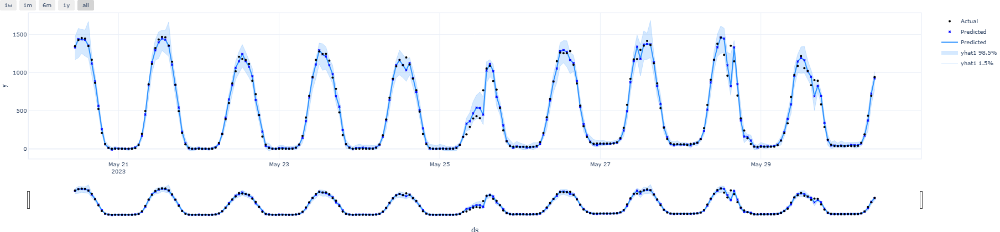

In [20]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

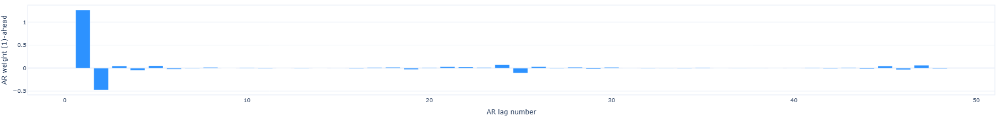

In [21]:
m.plot_parameters(components=["autoregression"])

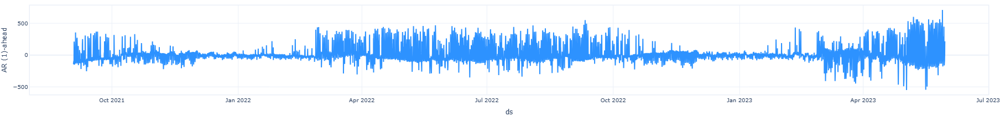

In [22]:
m.plot_components(forecast, components=["autoregression"])

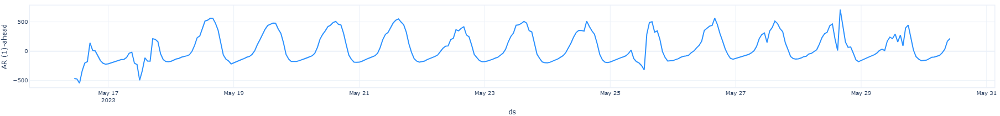

In [23]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

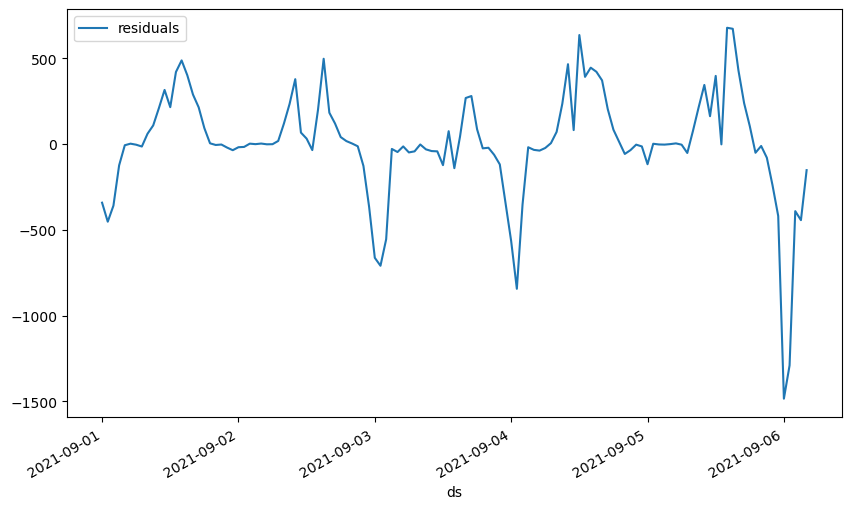

In [24]:
df_residuals = pd.DataFrame({"ds": np_df1["ds"], "residuals": np_df1["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

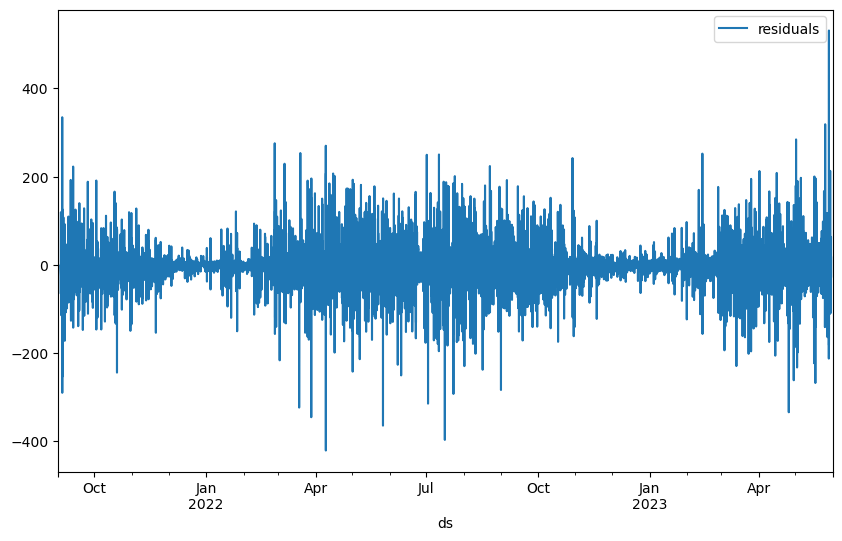

In [25]:
df_residuals = pd.DataFrame({"ds": np_df1.reset_index()["ds"], "residuals": np_df1.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




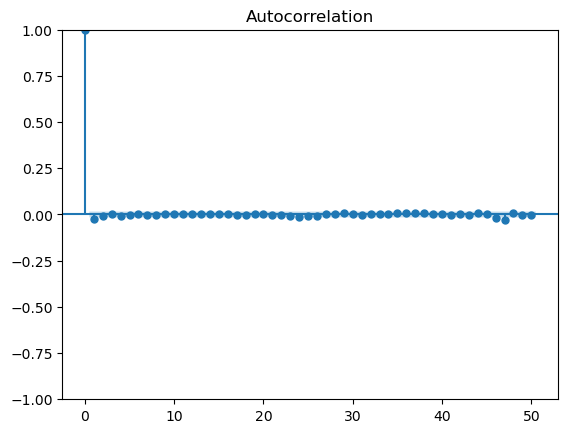

In [26]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




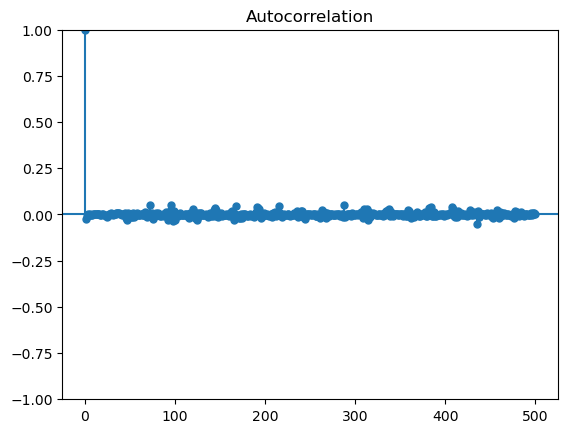

In [27]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

### Lagged Regressors Consumption

#### Consumption with no regressors first

Note: I had fun experimenting with hyperparameters for production - I'm just going to use those same ones for consumption so I can keep moving on. I'll do more optimisation on the final model from now on, rather than these interim/learning/educative models

In [149]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [150]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [151]:
# What happens if we lag the consumption target here?
lag_rs = ['production'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in lag_rs:
    m.add_lagged_regressor(r)

In [152]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [153]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
# np_df2_seasonal_regressor['temperature'] = full2_np.reset_index()['temperature']
# np_df1_seasonal_regressor['shortwave_radiation'] = full1_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                 4
ds                0
summer            0
winter            0
fall              0
spring            0
summer_weekday    0
summer_weekend    0
winter_weekday    0
winter_weekend    0
spring_weekday    0
spring_weekend    0
fall_weekday      0
fall_weekend      0
production        4
dtype: int64

In [154]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [155]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [156]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 120it [00:00, ?it/s]

In [157]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

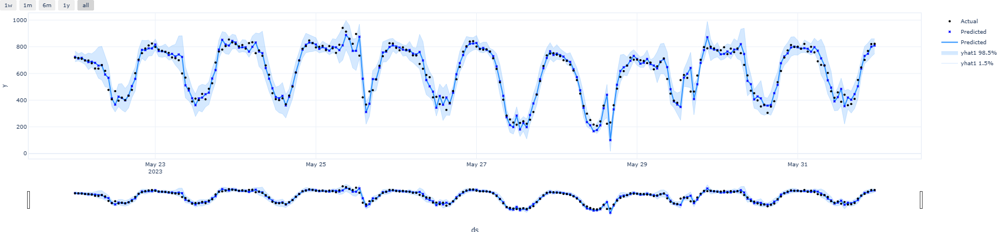

In [158]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

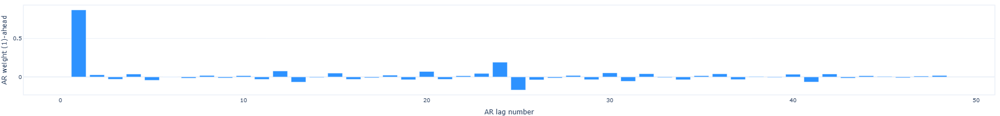

In [159]:
m.plot_parameters(components=["autoregression"])

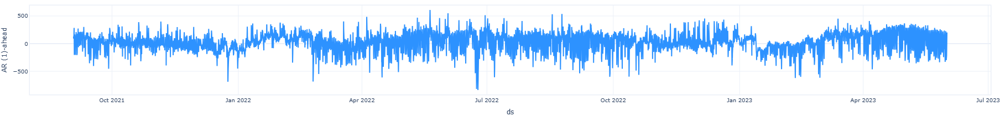

In [160]:
m.plot_components(forecast, components=["autoregression"])

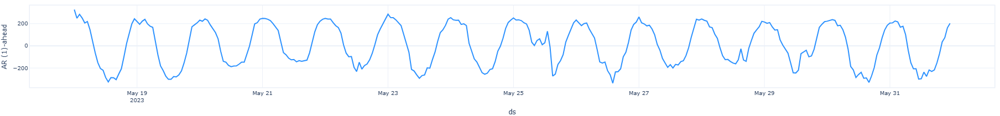

In [161]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

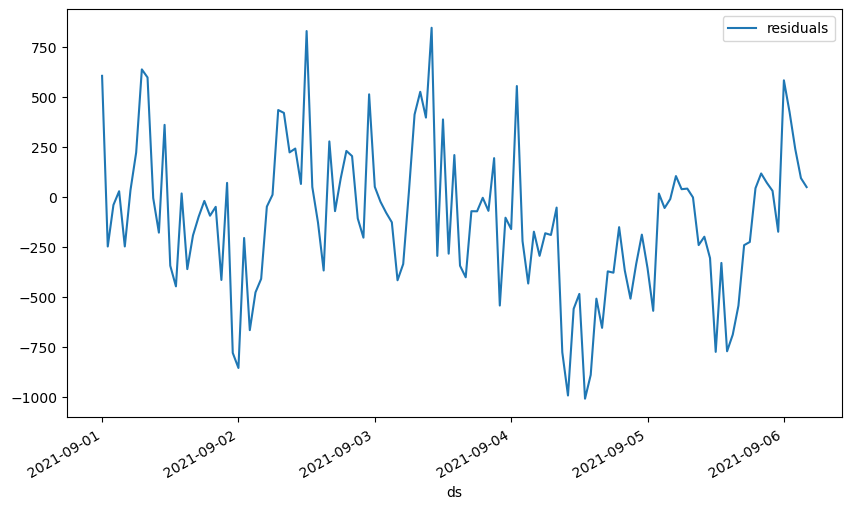

In [162]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

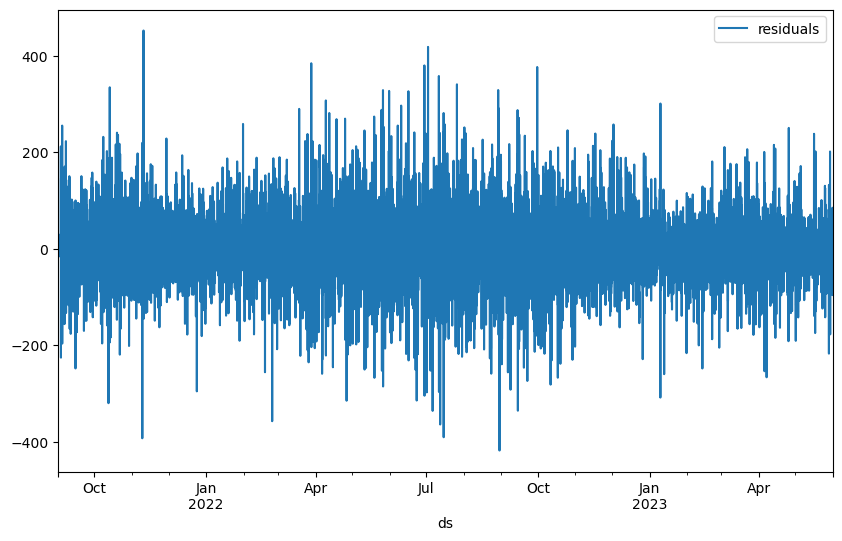

In [163]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




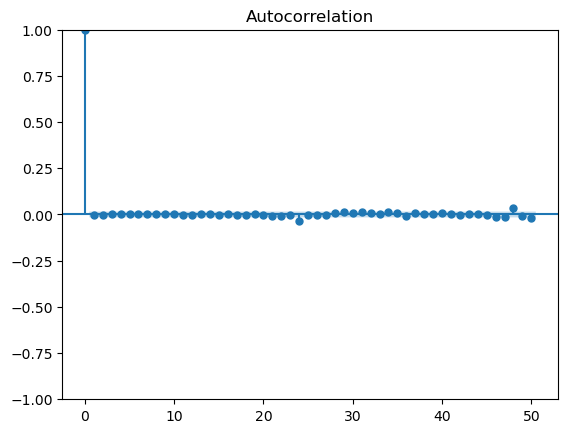

In [164]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




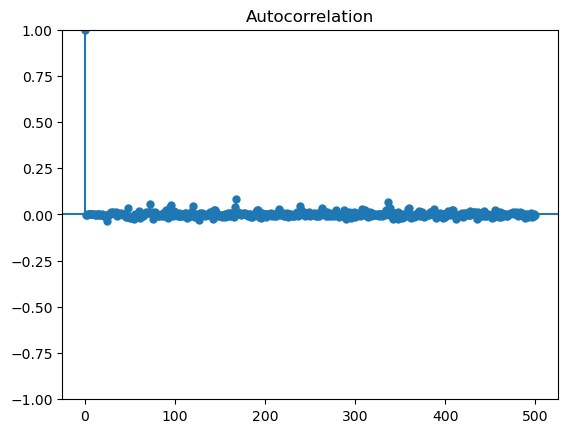

In [165]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

In [166]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [167]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [168]:
# What happens if we lag the consumption target here?
lag_rs = ['lowest_price_per_mwh'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in lag_rs:
    m.add_lagged_regressor(r)

In [169]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [170]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
# np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['lowest_price_per_mwh']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                        4
ds                       0
summer                   0
winter                   0
fall                     0
spring                   0
summer_weekday           0
summer_weekend           0
winter_weekday           0
winter_weekend           0
spring_weekday           0
spring_weekend           0
fall_weekday             0
fall_weekend             0
lowest_price_per_mwh    24
dtype: int64

In [171]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [172]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [173]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 120it [00:00, ?it/s]

In [174]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

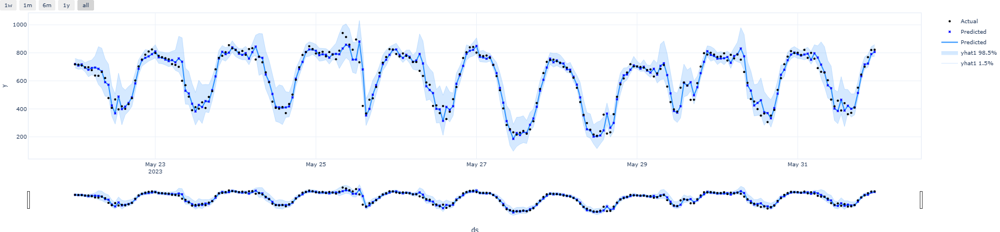

In [175]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

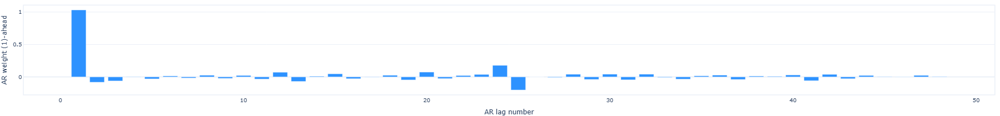

In [176]:
m.plot_parameters(components=["autoregression"])

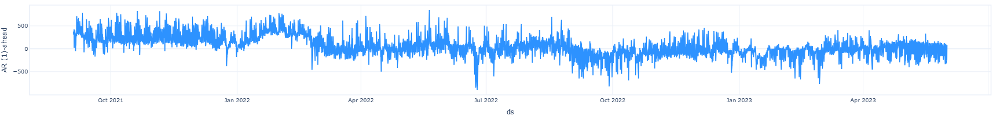

In [177]:
m.plot_components(forecast, components=["autoregression"])

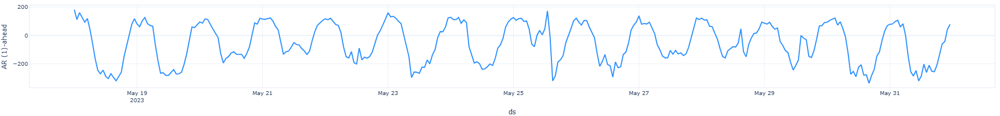

In [178]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

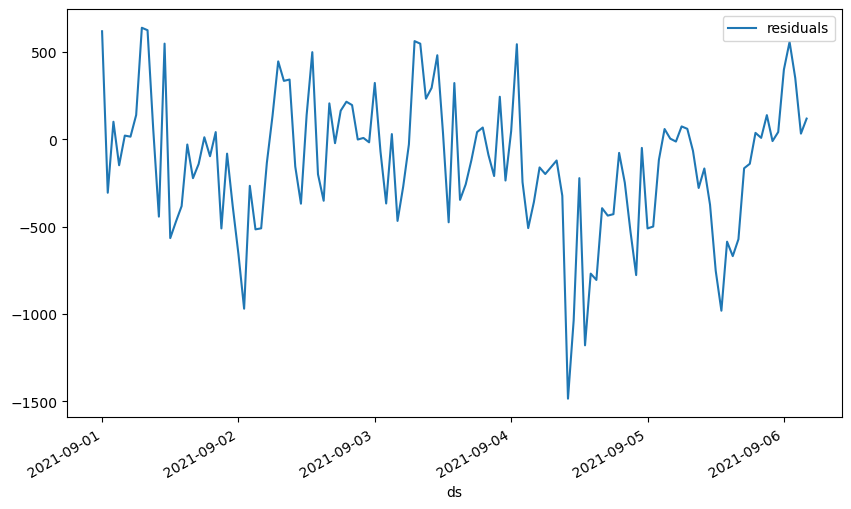

In [179]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

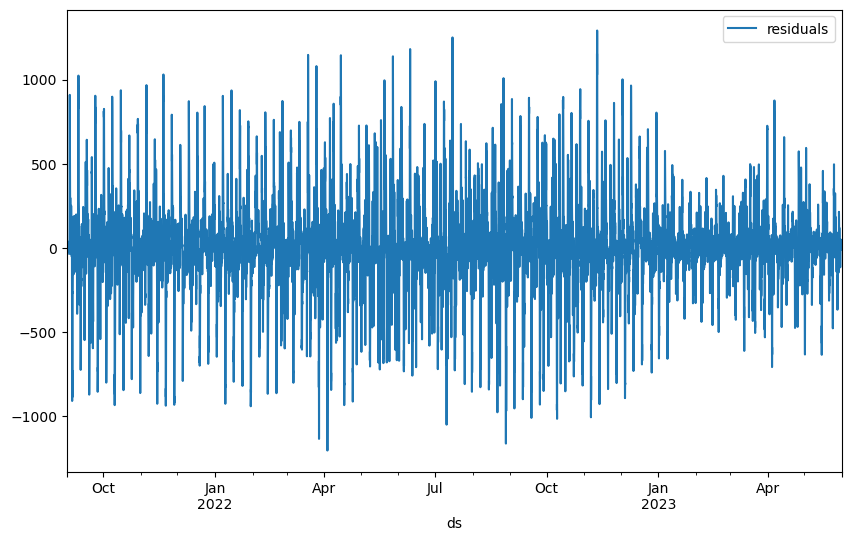

In [180]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




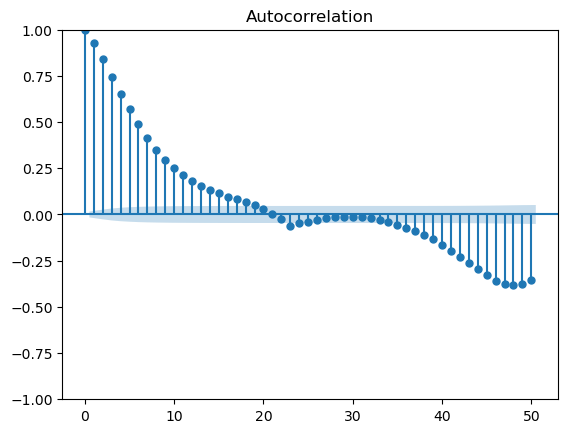

In [181]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




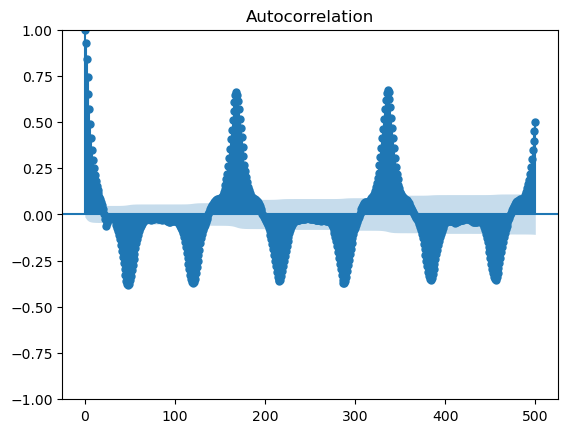

In [182]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

In [183]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [184]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [185]:
# What happens if we lag the consumption target here?
lag_rs = ['lowest_price_per_mwh'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in lag_rs:
    m.add_lagged_regressor(r)

In [186]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [187]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
# np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['lowest_price_per_mwh']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                        4
ds                       0
summer                   0
winter                   0
fall                     0
spring                   0
summer_weekday           0
summer_weekend           0
winter_weekday           0
winter_weekend           0
spring_weekday           0
spring_weekend           0
fall_weekday             0
fall_weekend             0
lowest_price_per_mwh    24
dtype: int64

In [188]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [189]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [190]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 120it [00:00, ?it/s]

In [191]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

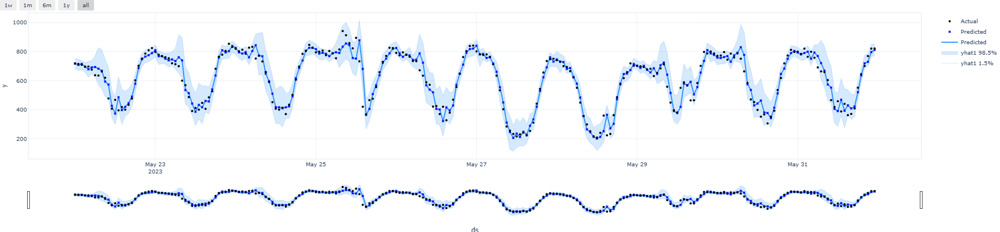

In [192]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

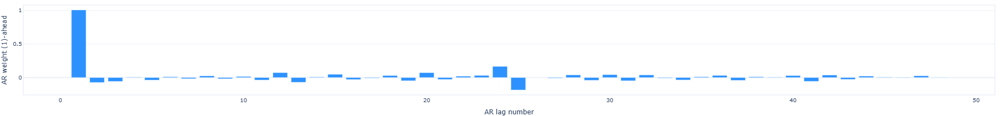

In [193]:
m.plot_parameters(components=["autoregression"])

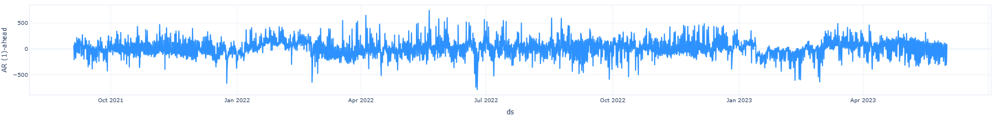

In [194]:
m.plot_components(forecast, components=["autoregression"])

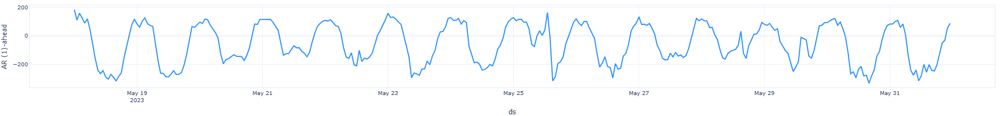

In [195]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

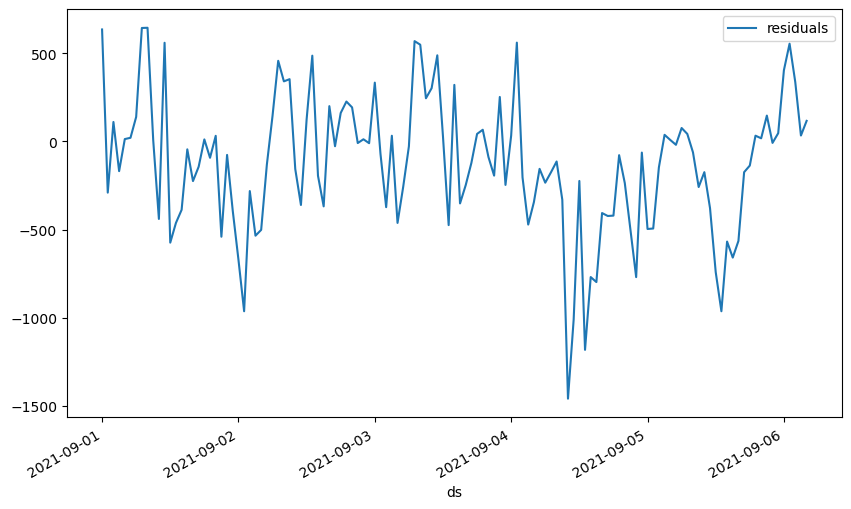

In [196]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

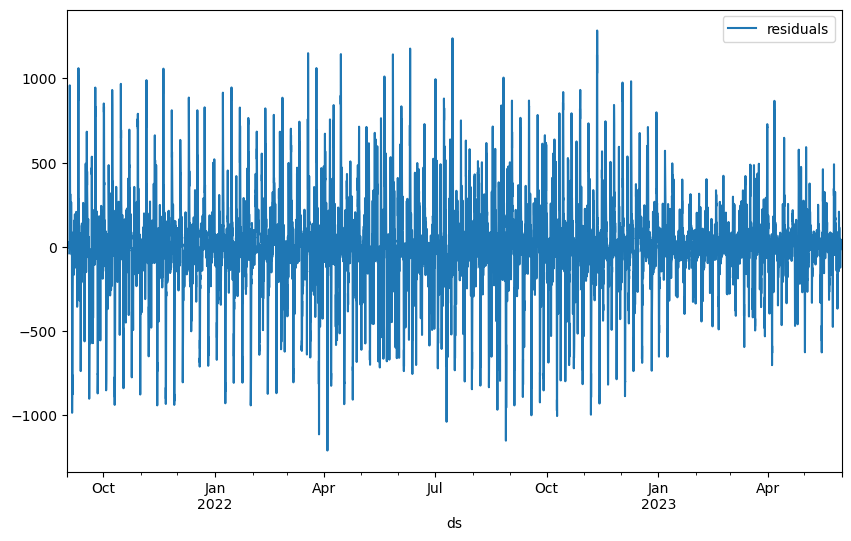

In [197]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




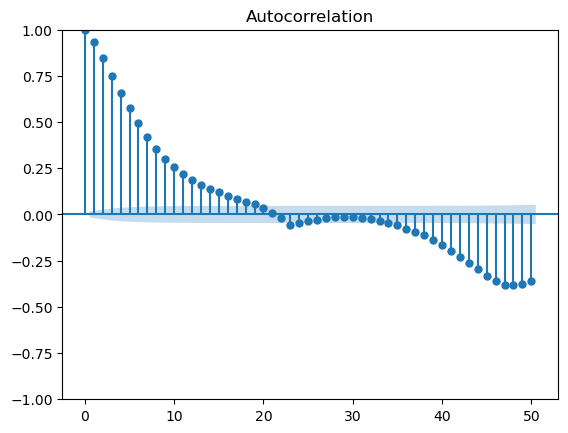

In [198]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




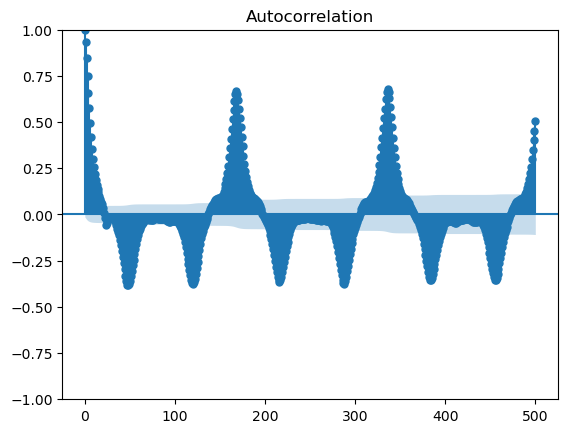

In [199]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

In [200]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [201]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [202]:
# What happens if we lag the consumption target here?
lag_rs = ['highest_price_per_mwh'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in lag_rs:
    m.add_lagged_regressor(r)

In [203]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [204]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
# np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['highest_price_per_mwh'] = full2_np.reset_index()['highest_price_per_mwh']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                         4
ds                        0
summer                    0
winter                    0
fall                      0
spring                    0
summer_weekday            0
summer_weekend            0
winter_weekday            0
winter_weekend            0
spring_weekday            0
spring_weekend            0
fall_weekday              0
fall_weekend              0
highest_price_per_mwh    24
dtype: int64

In [205]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [206]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [207]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 120it [00:00, ?it/s]

In [208]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

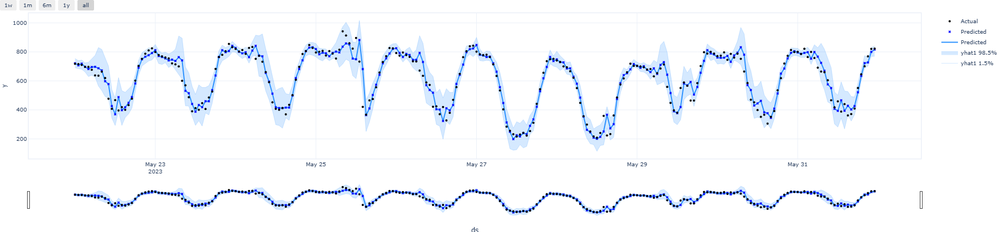

In [209]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

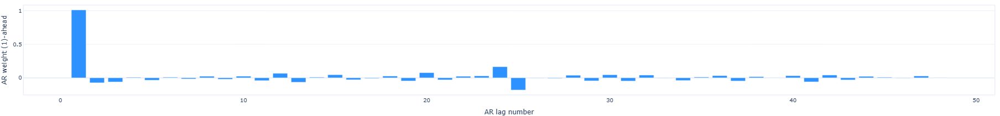

In [210]:
m.plot_parameters(components=["autoregression"])

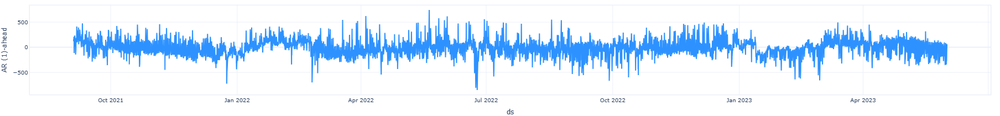

In [211]:
m.plot_components(forecast, components=["autoregression"])

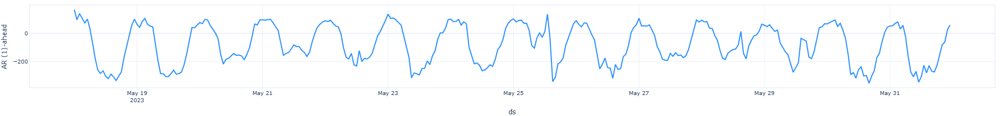

In [212]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

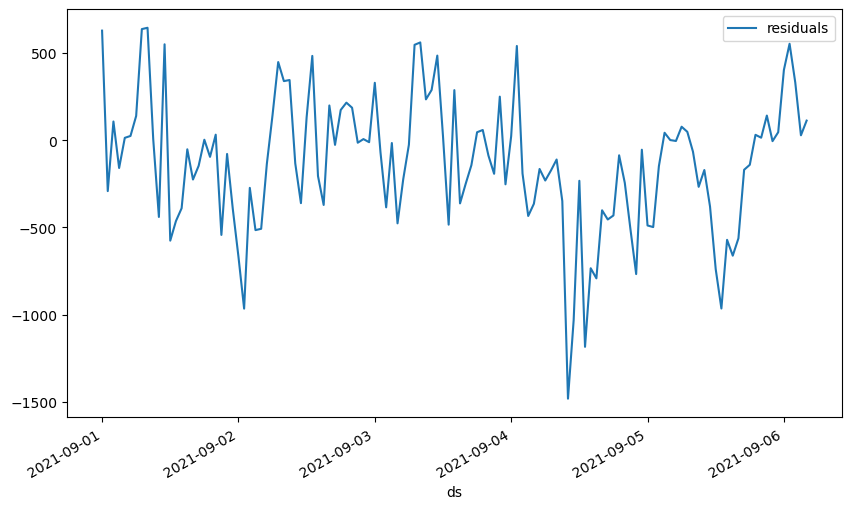

In [213]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

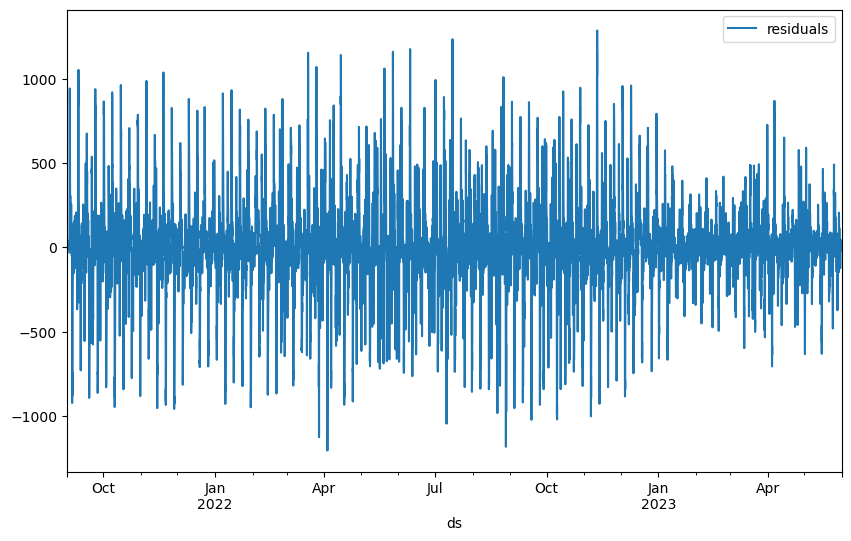

In [214]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




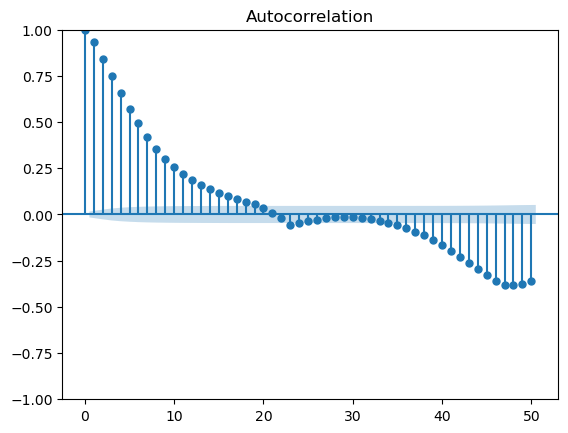

In [215]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




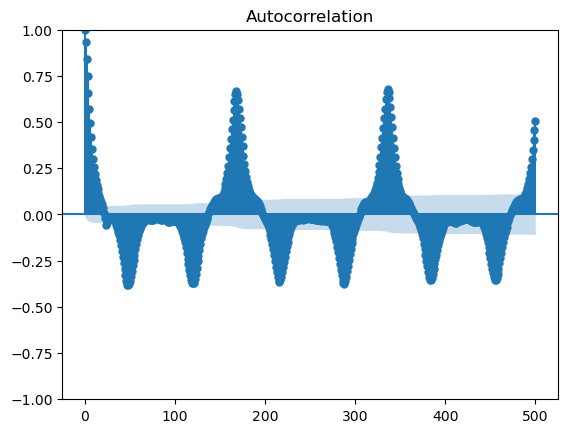

In [216]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

In [217]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [218]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [219]:
# What happens if we lag the consumption target here?
lag_rs = ['surface_solar_radiation_downwards'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in lag_rs:
    m.add_lagged_regressor(r)

In [220]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [221]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
# np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['surface_solar_radiation_downwards'] = full2_np.reset_index()['surface_solar_radiation_downwards']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                                     4
ds                                    0
summer                                0
winter                                0
fall                                  0
spring                                0
summer_weekday                        0
summer_weekend                        0
winter_weekday                        0
winter_weekend                        0
spring_weekday                        0
spring_weekend                        0
fall_weekday                          0
fall_weekend                          0
surface_solar_radiation_downwards    50
dtype: int64

In [222]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [223]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [224]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [225]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

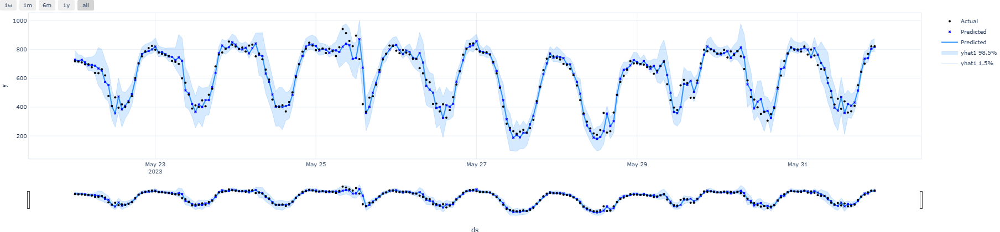

In [226]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

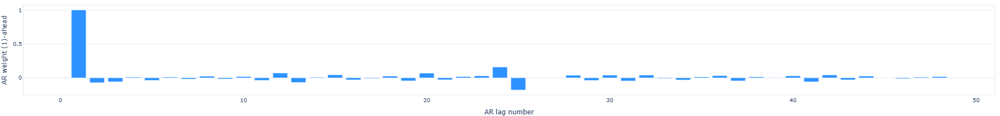

In [227]:
m.plot_parameters(components=["autoregression"])

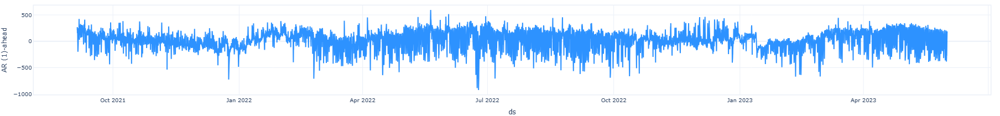

In [228]:
m.plot_components(forecast, components=["autoregression"])

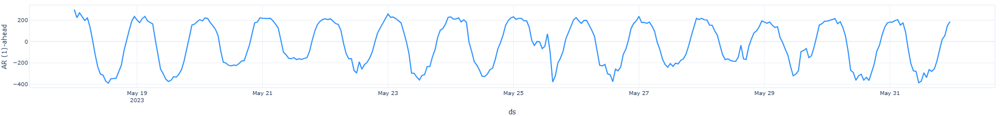

In [229]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

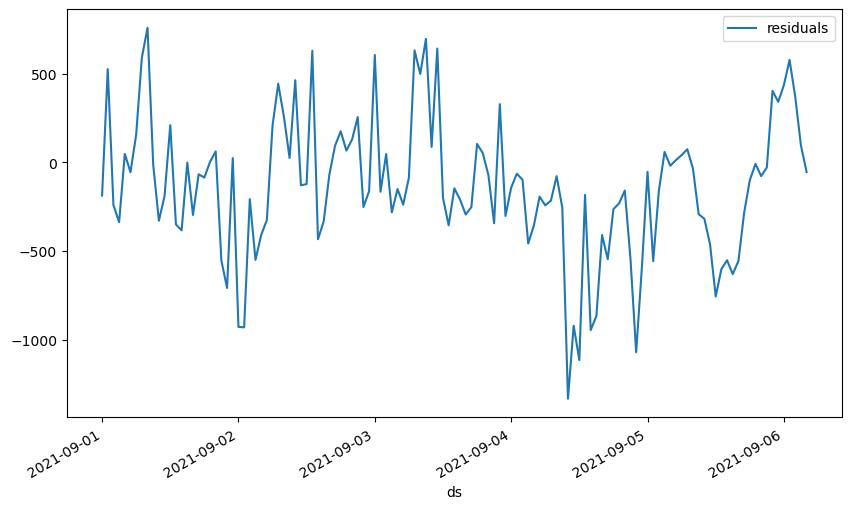

In [230]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

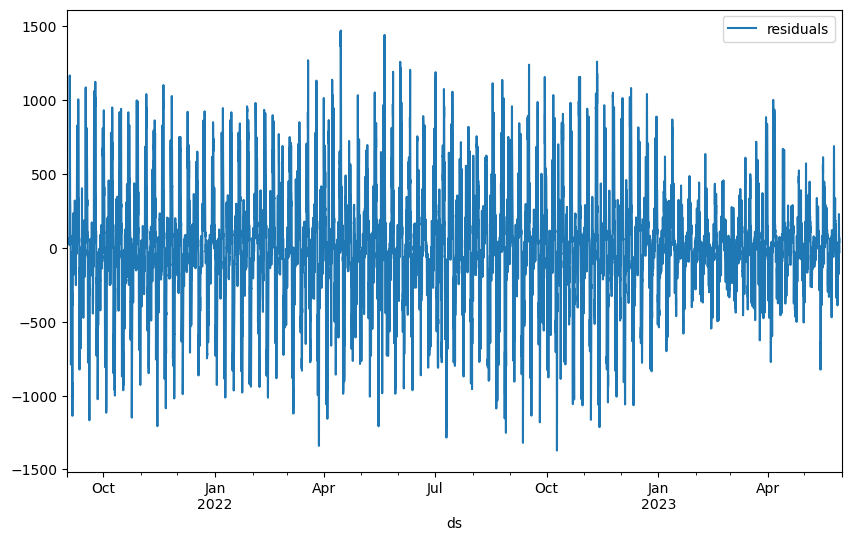

In [231]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




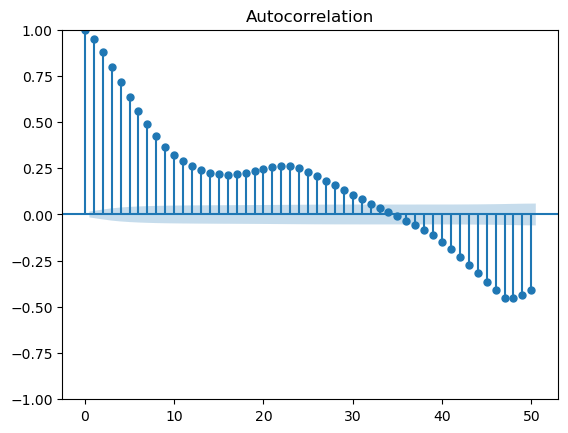

In [232]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




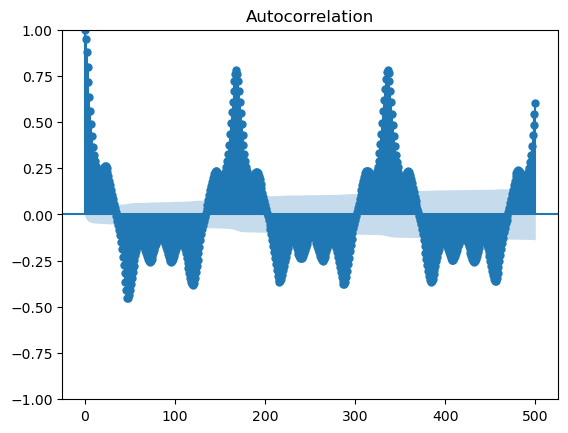

In [233]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

In [240]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [241]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [242]:
# What happens if we lag the consumption target here?
lag_rs = ['production', 'direct_solar_radiation'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in lag_rs:
    m.add_lagged_regressor(r)

In [243]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [244]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['direct_solar_radiation'] = full2_np.reset_index()['direct_solar_radiation']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                          4
ds                         0
summer                     0
winter                     0
fall                       0
spring                     0
summer_weekday             0
summer_weekend             0
winter_weekday             0
winter_weekend             0
spring_weekday             0
spring_weekend             0
fall_weekday               0
fall_weekend               0
production                 4
direct_solar_radiation    37
dtype: int64

In [245]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [246]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [247]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [248]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

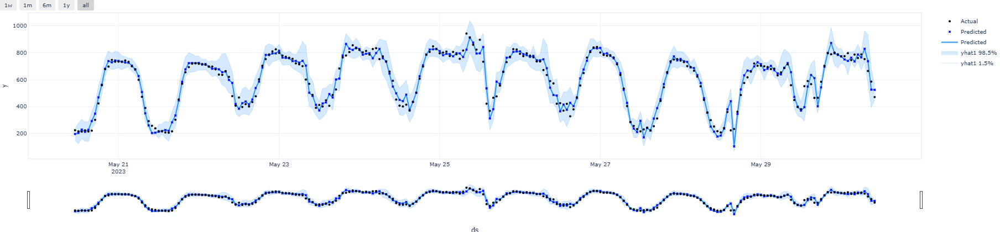

In [249]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

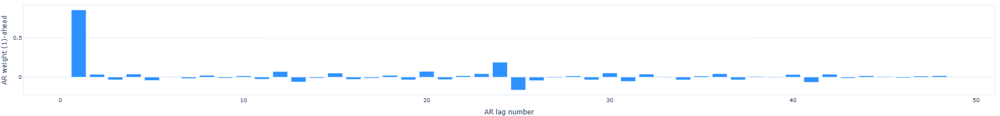

In [250]:
m.plot_parameters(components=["autoregression"])

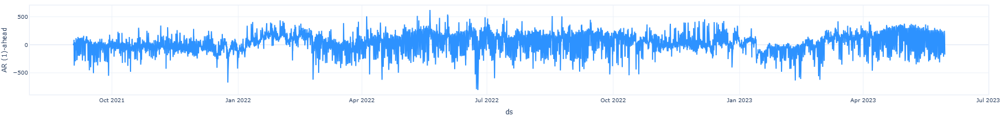

In [251]:
m.plot_components(forecast, components=["autoregression"])

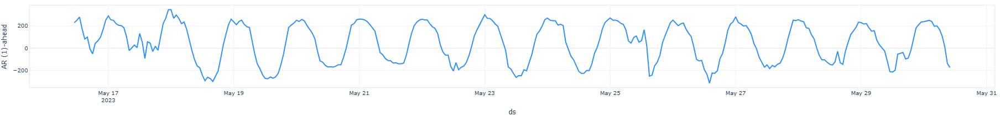

In [252]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

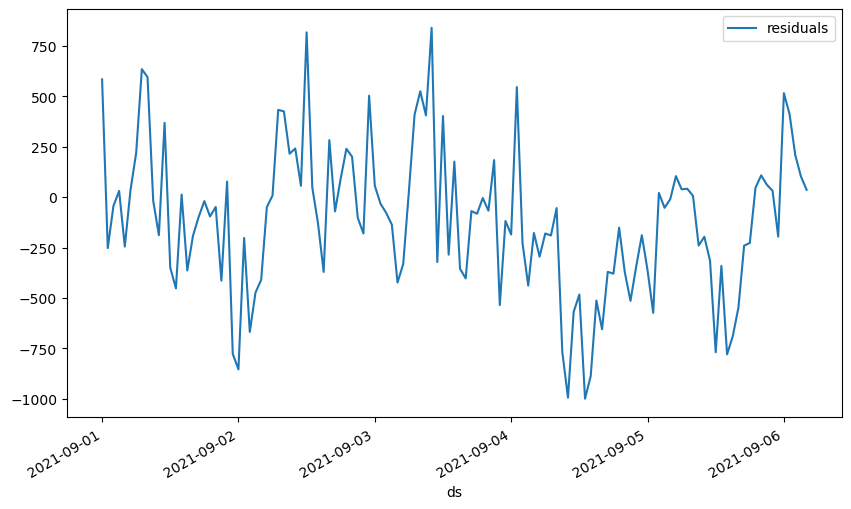

In [253]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

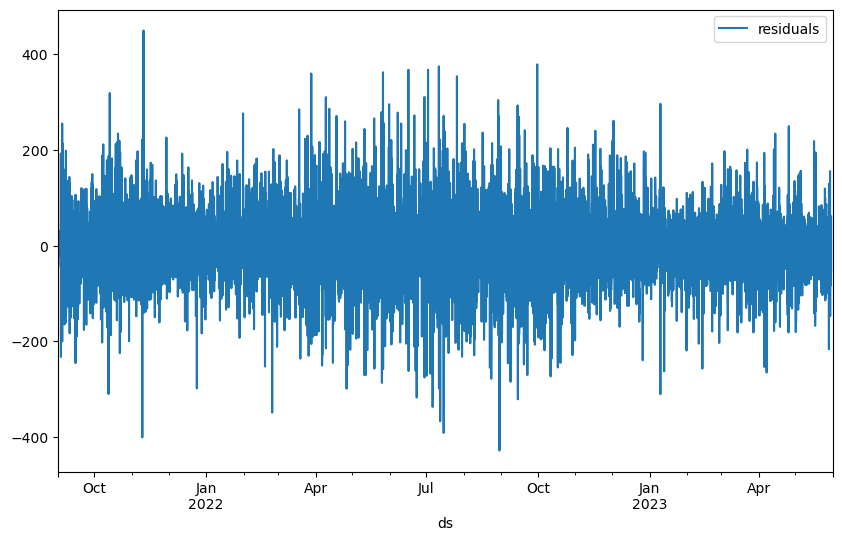

In [254]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




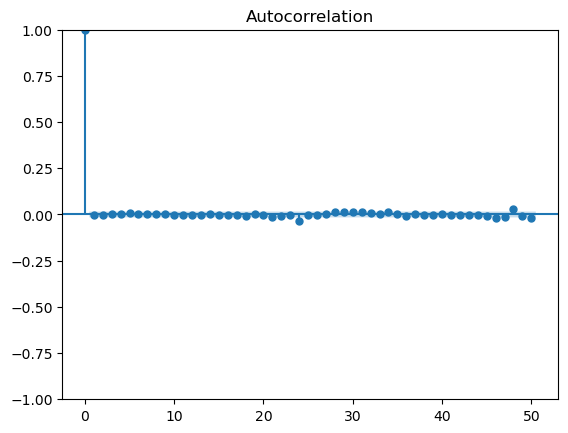

In [255]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




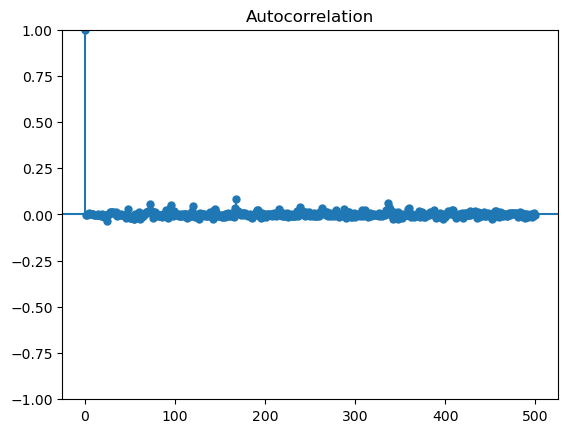

In [256]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

## Future Regressors

ALright, I think we're good with lagged regressors now. Now let's experiment with future regressors.

We have a weather forecast variables, _fw, which we can use. But I think I can also redo all the current variables as future regressors, because of the way I set up the dataset. All of the data in the rows are visible at test time, except the target, so I think we can use them all as future regressors. Truthfully, they don't perfectly matchup - many of them are data for the entire previous day rather than that timeperiod, but I had to join them somehow.

Anyways, let's redo the regressors but using future regressors instead, and see if we get better results.

#### Future Regressors Production

In [9]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [10]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [11]:
# What happens if we lag the consumption target here?
fut_rs = ['direct_solar_radiation'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in fut_rs:
    m.add_future_regressor(r)

In [12]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [13]:
np_df1_seasonal_regressor = np_df1_seasonal.copy().reset_index(drop=True)
# np_df1_seasonal_regressor['consumption'] = full2_np.reset_index()['y']
# np_df1_seasonal_regressor['direct_solar_radiation_fw'] = full1_np.reset_index()['direct_solar_radiation_fw']
np_df1_seasonal_regressor['direct_solar_radiation'] = full1_np.reset_index()['direct_solar_radiation']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df1_seasonal_regressor.isna().sum()

y                          4
ds                         0
summer                     0
winter                     0
fall                       0
spring                     0
summer_weekday             0
summer_weekend             0
winter_weekday             0
winter_weekend             0
spring_weekday             0
spring_weekend             0
fall_weekday               0
fall_weekend               0
direct_solar_radiation    37
dtype: int64

In [14]:
np_df1_seasonal_regressor = np_df1_seasonal_regressor.dropna()

In [15]:
# Fit model
metrics_fit = m.fit(np_df1_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

We got 0.2 MAE increase

In [16]:
forecast = m.predict(np_df1_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [17]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

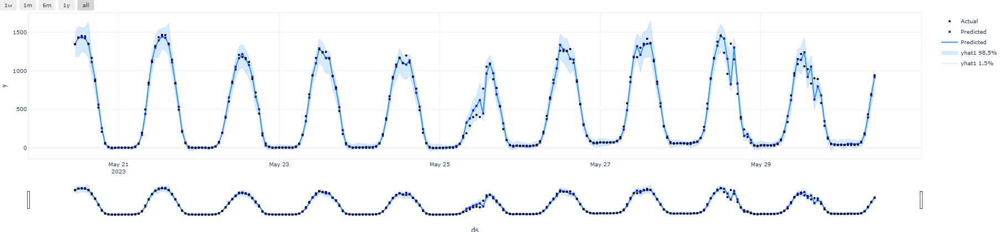

In [18]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

In [19]:
import sklearn.metrics as metrics

metrics.mean_absolute_error(forecast.iloc[-10 * 24 :].y, forecast.iloc[-10 * 24 :].yhat1)

33.409346746499594

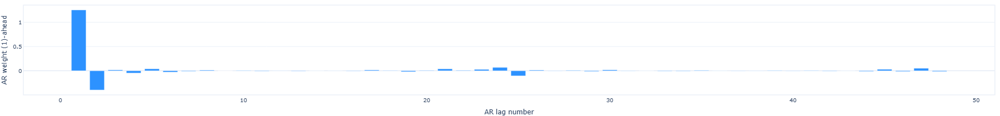

In [20]:
m.plot_parameters(components=["autoregression"])

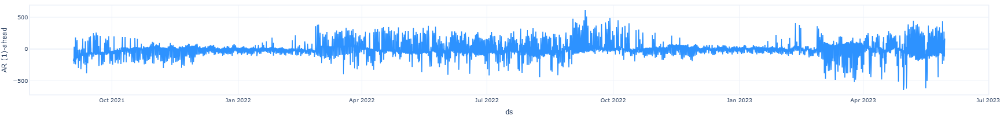

In [21]:
m.plot_components(forecast, components=["autoregression"])

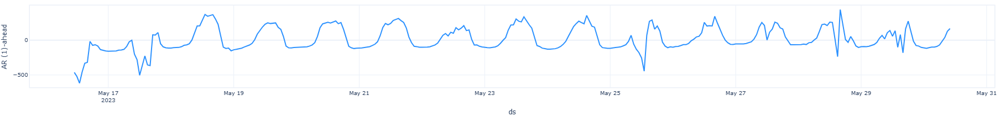

In [22]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

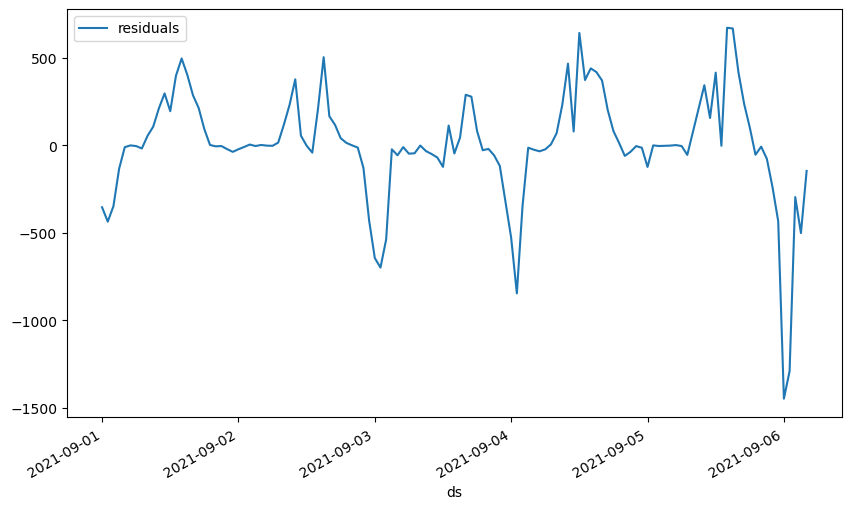

In [23]:
df_residuals = pd.DataFrame({"ds": np_df1["ds"], "residuals": np_df1["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

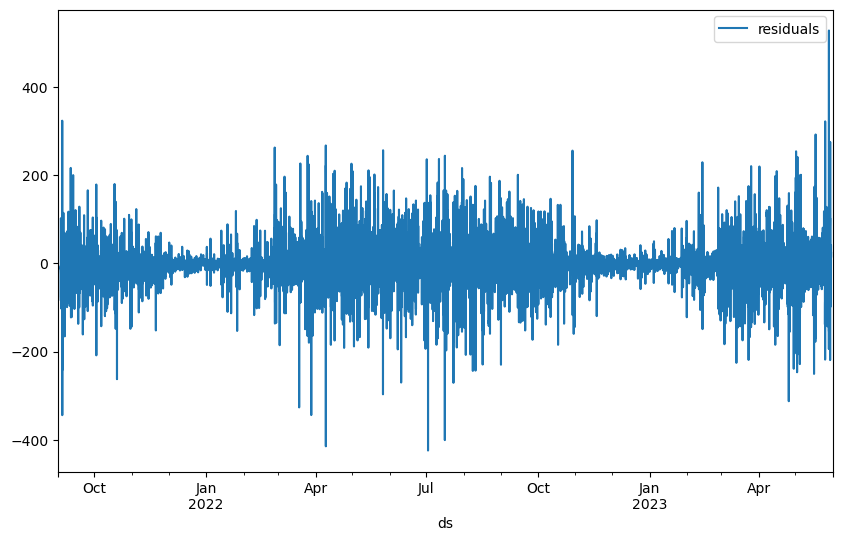

In [24]:
df_residuals = pd.DataFrame({"ds": np_df1.reset_index()["ds"], "residuals": np_df1.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_21496\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




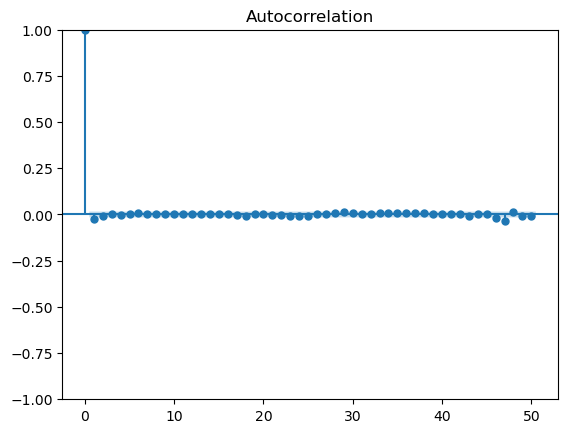

In [25]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_21496\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




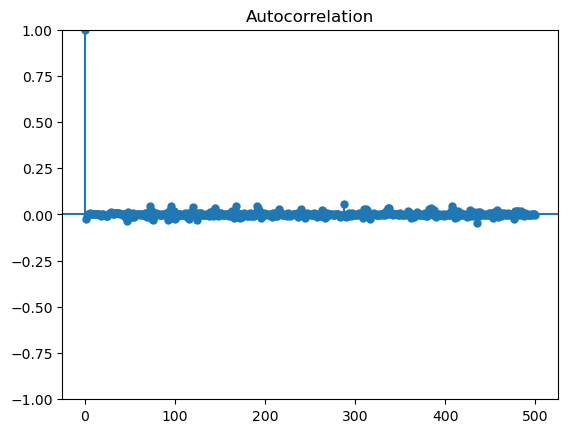

In [26]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

#### Now let's try with the _fw variable

In [309]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [310]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [13]:
# What happens if we lag the consumption target here?
fut_rs = ['direct_solar_radiation_fw'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in fut_rs:
    m.add_future_regressor(r)

In [14]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [15]:
np_df1_seasonal_regressor = np_df1_seasonal.copy().reset_index(drop=True)
# np_df1_seasonal_regressor['consumption'] = full2_np.reset_index()['y']
np_df1_seasonal_regressor['direct_solar_radiation'] = full1_np.reset_index()['direct_solar_radiation']
# np_df1_seasonal_regressor['shortwave_radiation'] = full1_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df1_seasonal_regressor.isna().sum()

y                          4
ds                         0
summer                     0
winter                     0
fall                       0
spring                     0
summer_weekday             0
summer_weekend             0
winter_weekday             0
winter_weekend             0
spring_weekday             0
spring_weekend             0
fall_weekday               0
fall_weekend               0
direct_solar_radiation    37
dtype: int64

In [16]:
np_df1_seasonal_regressor = np_df1_seasonal_regressor.dropna()

In [17]:
# Fit model
metrics_fit = m.fit(np_df1_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

We got 0.2 MAE increase

In [18]:
forecast = m.predict(np_df1_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [19]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

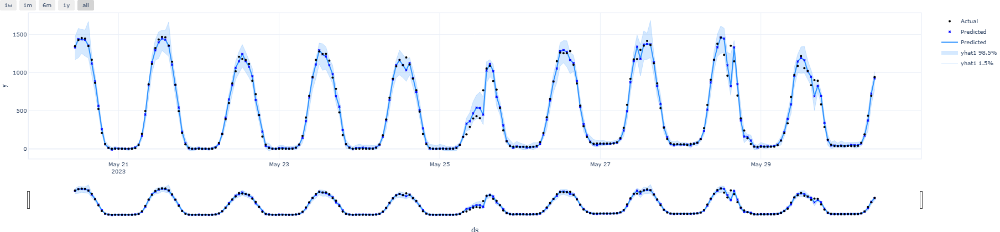

In [20]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

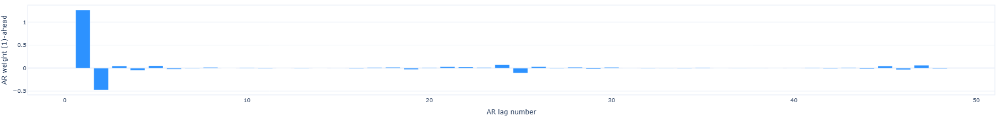

In [21]:
m.plot_parameters(components=["autoregression"])

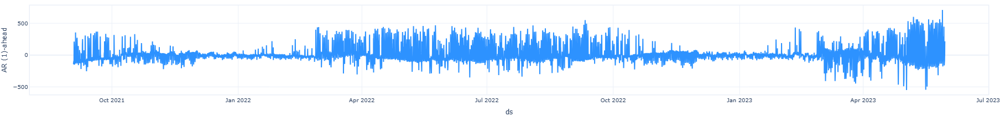

In [22]:
m.plot_components(forecast, components=["autoregression"])

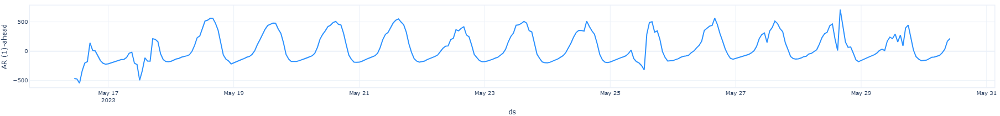

In [23]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

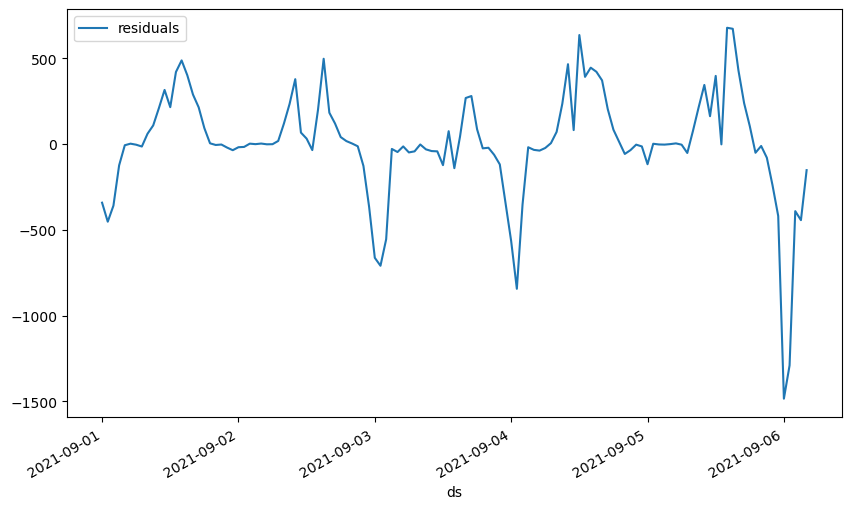

In [24]:
df_residuals = pd.DataFrame({"ds": np_df1["ds"], "residuals": np_df1["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

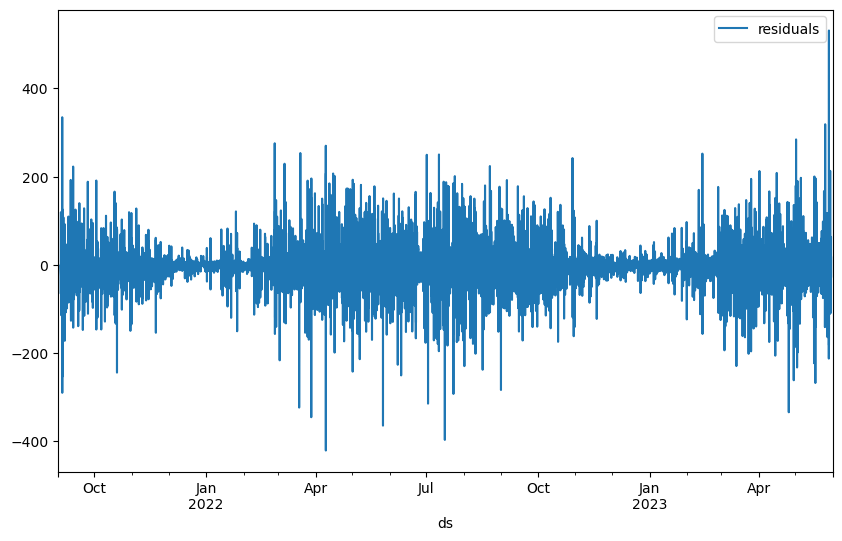

In [25]:
df_residuals = pd.DataFrame({"ds": np_df1.reset_index()["ds"], "residuals": np_df1.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




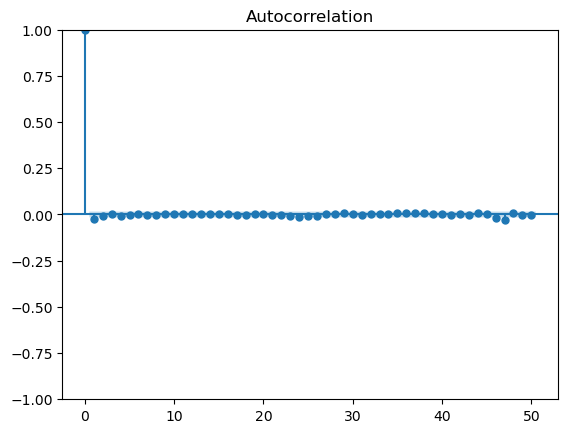

In [26]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




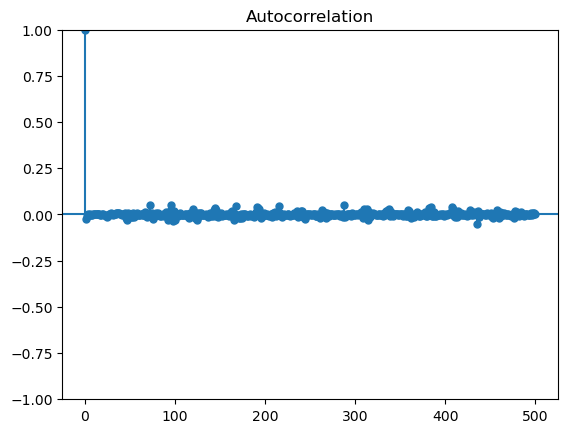

In [27]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

#### Future Regressors Consumption

In [27]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [28]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [29]:
# What happens if we lag the consumption target here?
lag_rs = ['production'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']
fut_rs = ['direct_solar_radiation']
for r in lag_rs:
    m.add_lagged_regressor(r)
for r in fut_rs:
    m.add_future_regressor(r)

In [30]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [31]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['direct_solar_radiation'] = full2_np.reset_index()['direct_solar_radiation']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                          4
ds                         0
summer                     0
winter                     0
fall                       0
spring                     0
summer_weekday             0
summer_weekend             0
winter_weekday             0
winter_weekend             0
spring_weekday             0
spring_weekend             0
fall_weekday               0
fall_weekend               0
production                 4
direct_solar_radiation    37
dtype: int64

In [32]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [33]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [34]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [35]:
import sklearn.metrics as metrics

metrics.mean_absolute_error(forecast.iloc[-10 * 24 :].y, forecast.iloc[-10 * 24 :].yhat1)

31.91432599436442

In [36]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

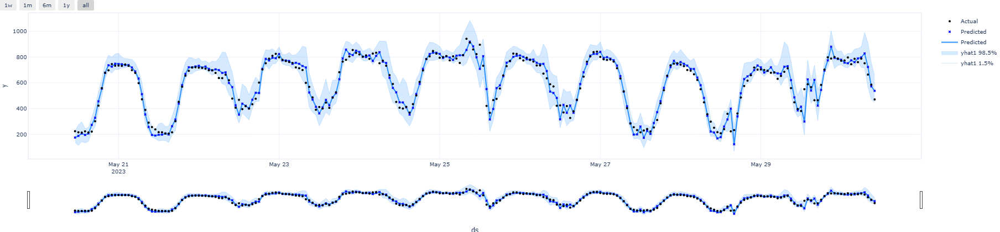

In [37]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

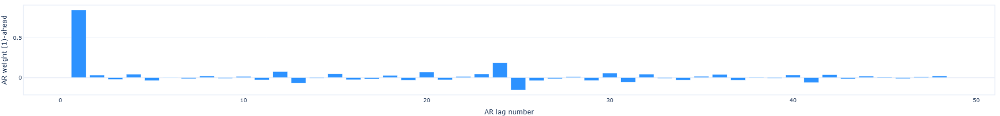

In [38]:
m.plot_parameters(components=["autoregression"])

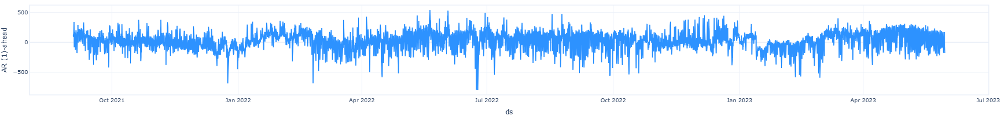

In [39]:
m.plot_components(forecast, components=["autoregression"])

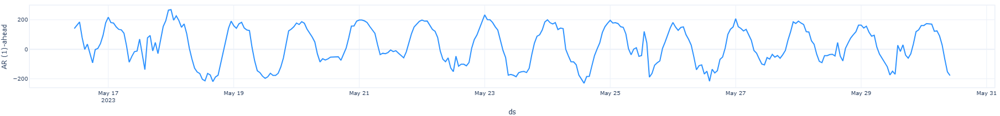

In [40]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

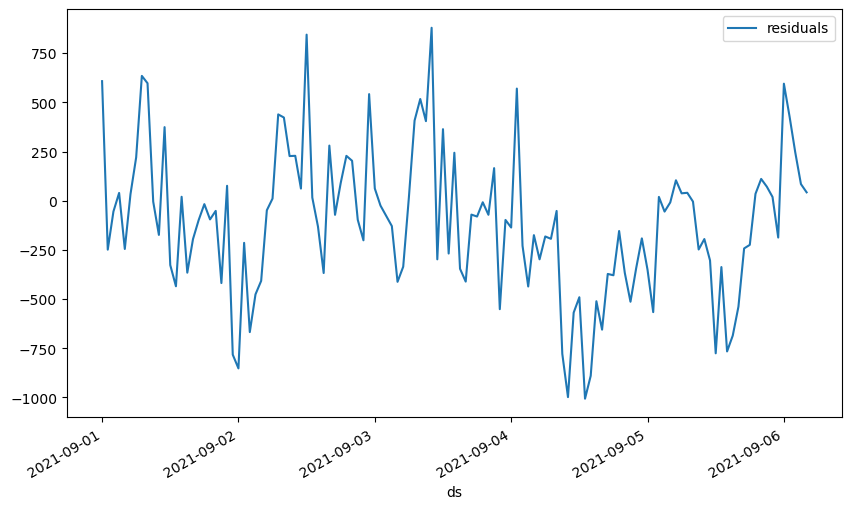

In [41]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

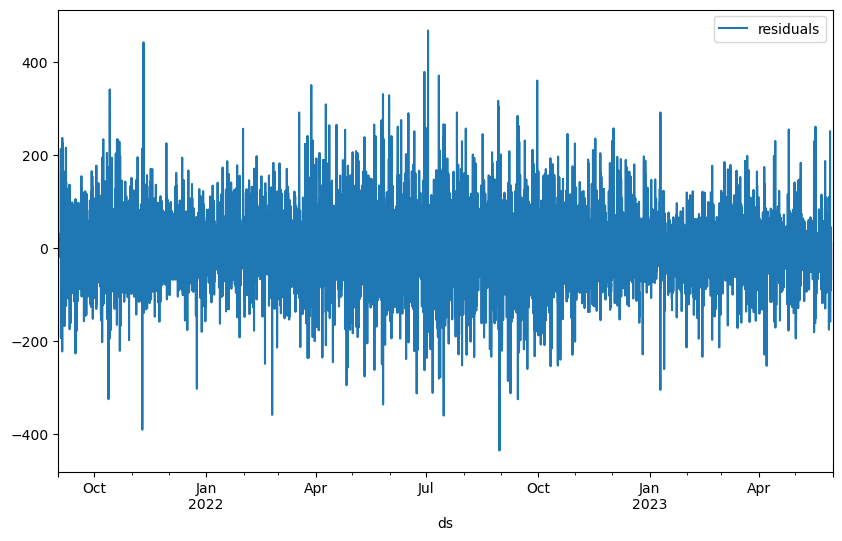

In [42]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_21496\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




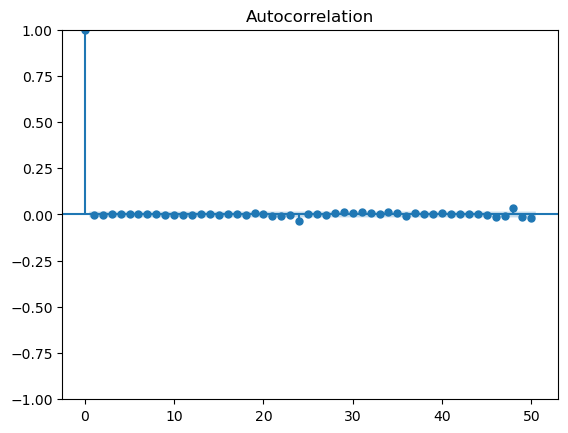

In [43]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_21496\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




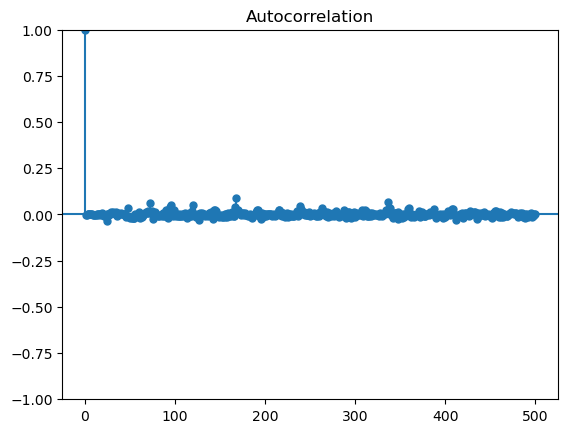

In [44]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

In [353]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

In [354]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [355]:
# What happens if we lag the consumption target here?
lag_rs = ['production'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']
fut_rs = ['direct_solar_radiation_fw']
for r in lag_rs:
    m.add_lagged_regressor(r)
for r in fut_rs:
    m.add_future_regressor(r)

In [356]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [357]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['direct_solar_radiation_fw'] = full2_np.reset_index()['direct_solar_radiation_fw']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                             4
ds                            0
summer                        0
winter                        0
fall                          0
spring                        0
summer_weekday                0
summer_weekend                0
winter_weekday                0
winter_weekend                0
spring_weekday                0
spring_weekend                0
fall_weekday                  0
fall_weekend                  0
production                    4
direct_solar_radiation_fw    50
dtype: int64

In [358]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [359]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

In [360]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [361]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

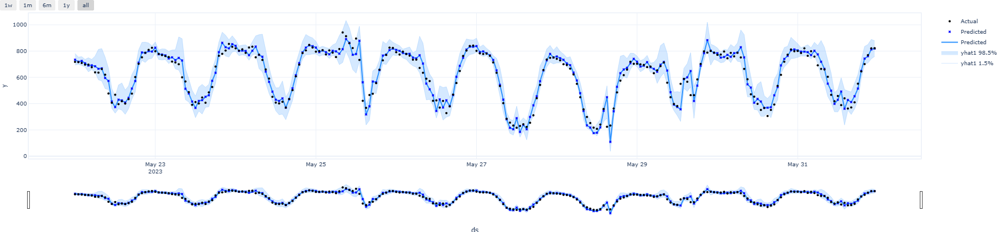

In [362]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

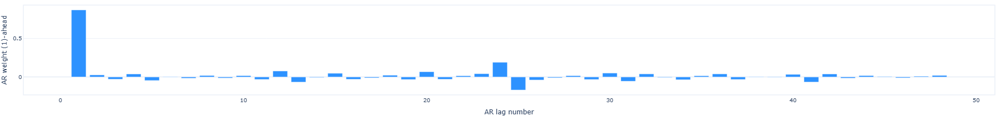

In [363]:
m.plot_parameters(components=["autoregression"])

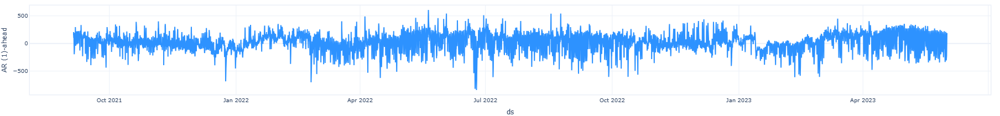

In [364]:
m.plot_components(forecast, components=["autoregression"])

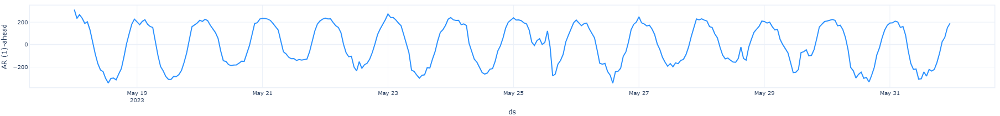

In [365]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

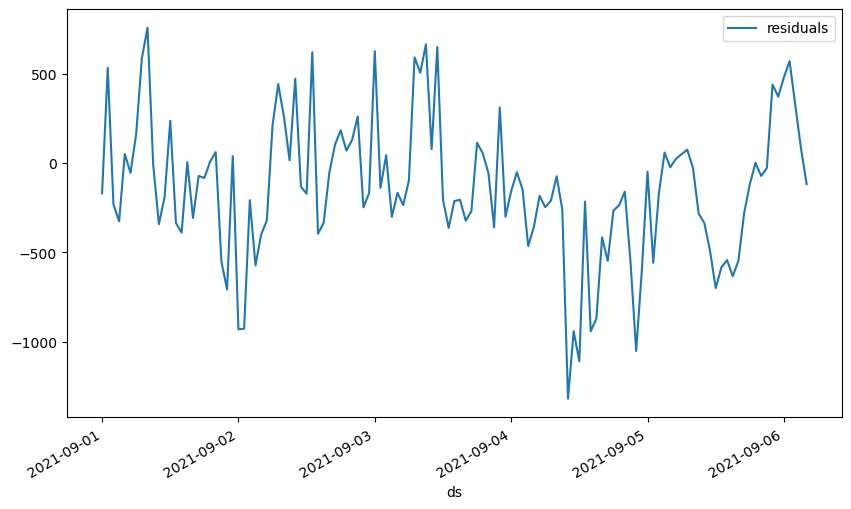

In [366]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

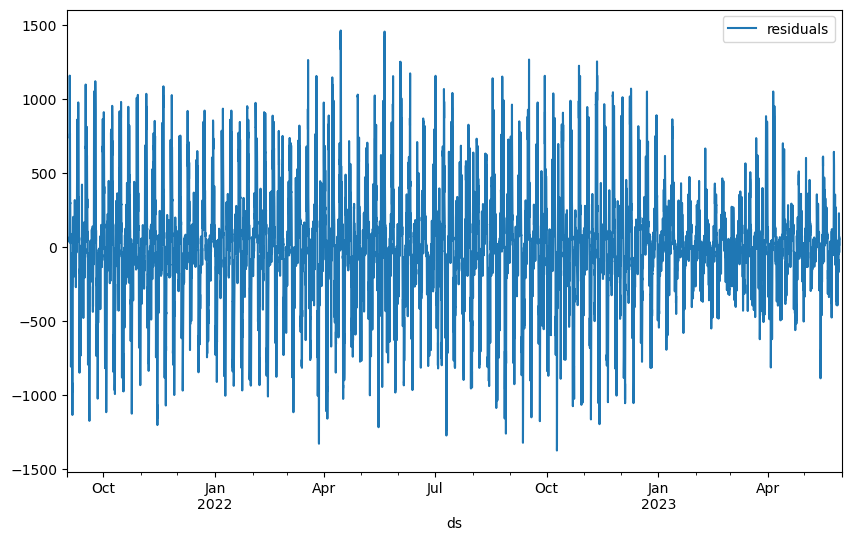

In [367]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




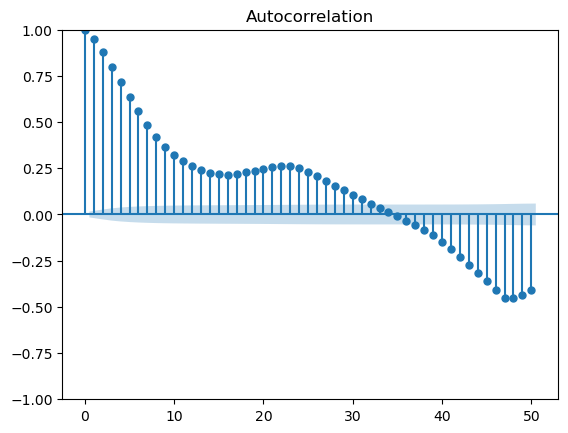

In [368]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




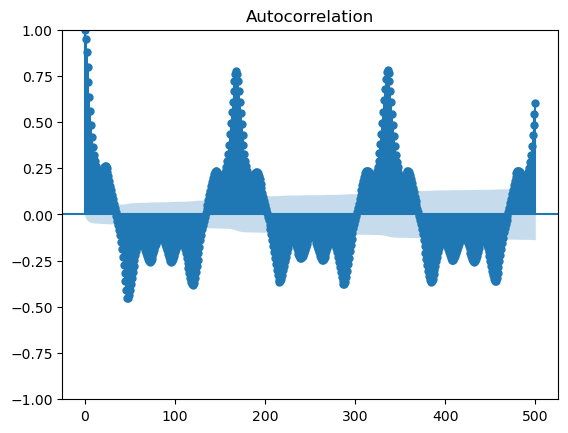

In [369]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

## Holidays!

Now, let's add holidays

In [387]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

m = m.add_country_holidays("Estonia")

In [388]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [389]:
# What happens if we lag the consumption target here?
fut_rs = ['direct_solar_radiation'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']

for r in fut_rs:
    m.add_future_regressor(r)

In [390]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [391]:
np_df1_seasonal_regressor = np_df1_seasonal.copy().reset_index(drop=True)
# np_df1_seasonal_regressor['consumption'] = full2_np.reset_index()['y']
np_df1_seasonal_regressor['direct_solar_radiation'] = full1_np.reset_index()['direct_solar_radiation']
# np_df1_seasonal_regressor['shortwave_radiation'] = full1_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df1_seasonal_regressor.isna().sum()

y                          4
ds                         0
summer                     0
winter                     0
fall                       0
spring                     0
summer_weekday             0
summer_weekend             0
winter_weekday             0
winter_weekend             0
spring_weekday             0
spring_weekend             0
fall_weekday               0
fall_weekend               0
direct_solar_radiation    37
dtype: int64

In [392]:
np_df1_seasonal_regressor = np_df1_seasonal_regressor.dropna()

In [393]:
# Fit model
metrics_fit = m.fit(np_df1_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

We got 0.2 MAE increase

In [394]:
forecast = m.predict(np_df1_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [395]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

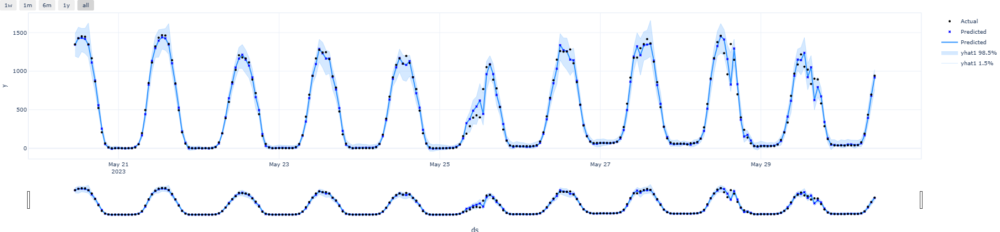

In [396]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

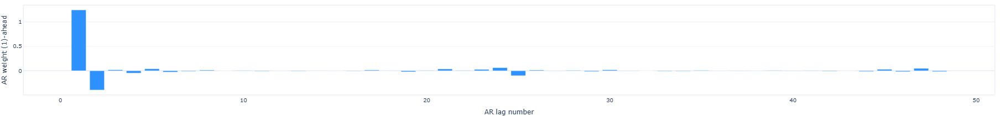

In [397]:
m.plot_parameters(components=["autoregression"])

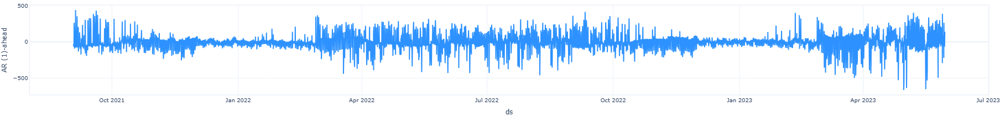

In [398]:
m.plot_components(forecast, components=["autoregression"])

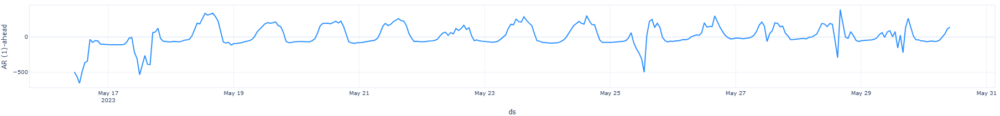

In [399]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

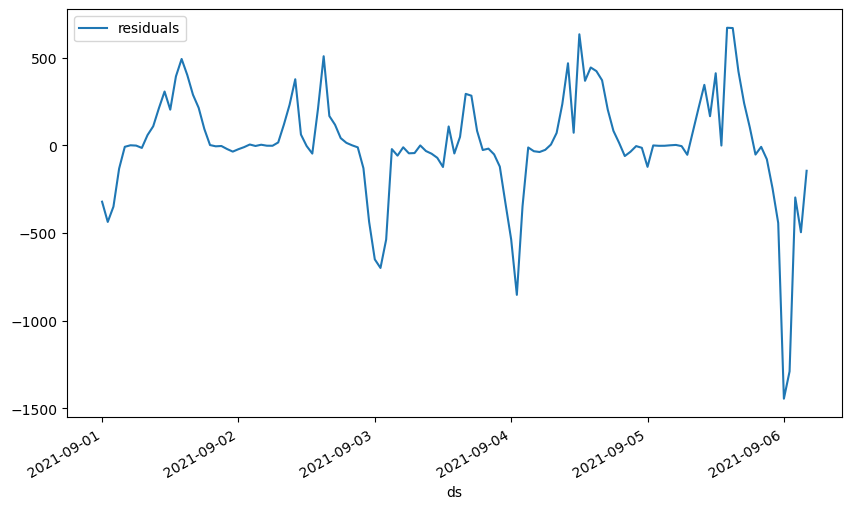

In [400]:
df_residuals = pd.DataFrame({"ds": np_df1["ds"], "residuals": np_df1["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

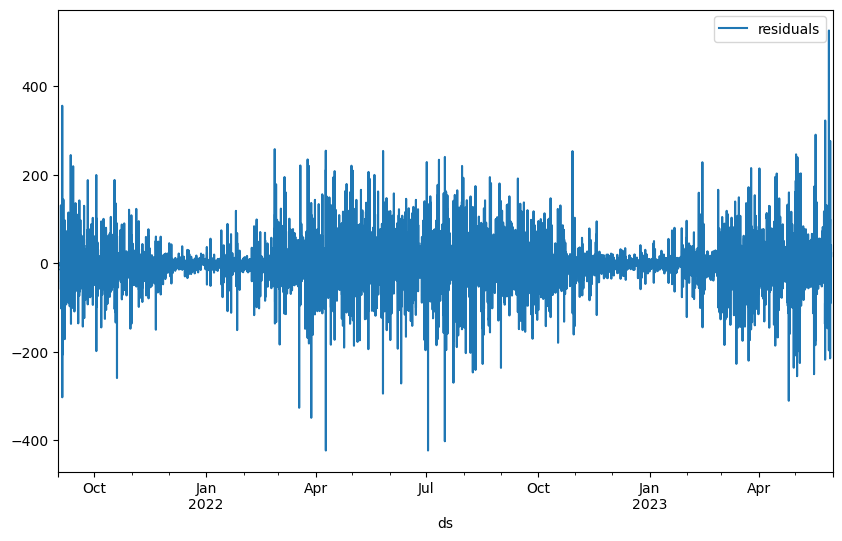

In [401]:
df_residuals = pd.DataFrame({"ds": np_df1.reset_index()["ds"], "residuals": np_df1.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




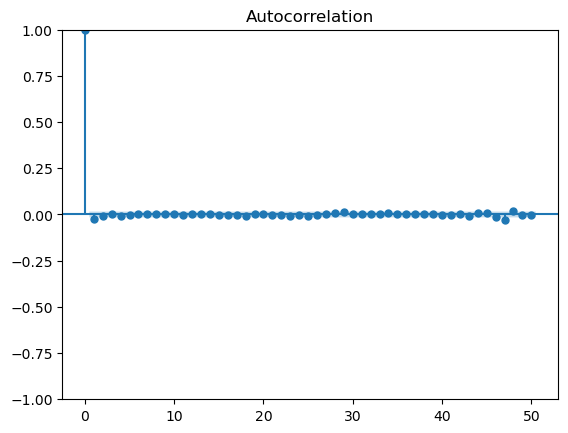

In [402]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




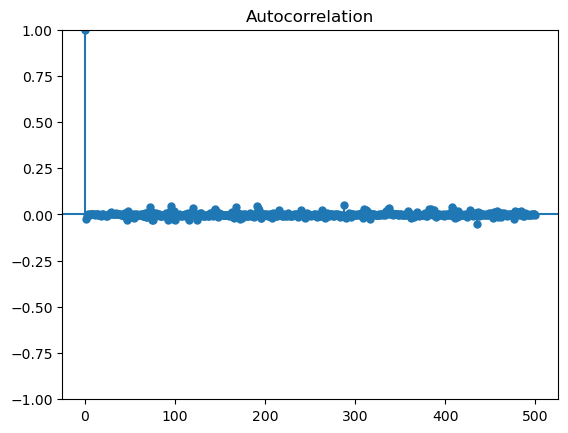

In [403]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )

#### HolidaysConsumption

In [404]:
#There's a few things we can adjust though...

# trainer_config = {"accelerator":"gpu"}

# Model and prediction
m = NeuralProphet(
    seasonality_mode="multiplicative",
    # Enable trend changepoints - let's add more
    n_changepoints=40,
    quantiles = [0.015, 0.985],
    # Enable seasonality components
    yearly_seasonality=15, # apparently we can also set the number of fourier terms to generate here, so let's pick a num
    weekly_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    daily_seasonality=False, # - Disable weekly seasonal for our own weekly conditional seasonal components
    n_lags=48,
    epochs = 200,
    learning_rate=0.006,
    batch_size=128, 
    # trainer_config=trainer_config
)
m.set_plotting_backend("plotly")

m = m.add_country_holidays("Estonia")

In [405]:
full1_np.columns[127:200]

Index(['data_block_id_hw_variances_hw_lagged', 'location_id_hw_lagged',
       'latitude_fw', 'longitude_fw', 'origin_datetime', 'hours_ahead',
       'temperature_fw', 'dewpoint_fw', 'cloudcover_high_fw',
       'cloudcover_low_fw', 'cloudcover_mid_fw', 'cloudcover_total_fw',
       '10_metre_u_wind_component', '10_metre_v_wind_component',
       'data_block_id_fw', 'forecast_datetime', 'direct_solar_radiation_fw',
       'surface_solar_radiation_downwards', 'snowfall_fw',
       'total_precipitation', 'euros_per_mwh', 'data_block_id_elec',
       'mean_euros_per_mwh_last_week',
       'mean_euros_per_mwh_same_hour_last_week', 'yesterdays_euros_per_mwh',
       'euros_per_mwh_24h_average_price', 'forecast_date',
       'lowest_price_per_mwh', 'highest_price_per_mwh', 'origin_date',
       'data_block_id_gasp', 'lowest_price_3d_avg', 'highest_price_3d_avg',
       'lowest_price_7d_avg', 'highest_price_7d_avg', 'lowest_price_14d_avg',
       'highest_price_14d_avg', 'year', 'month', 'da

In [406]:
# What happens if we lag the consumption target here?
lag_rs = ['production'] #['consumption', 'direct_solar_radiation', 'lowest_price_per_mwh'] #'installed_capacity', 'eic_count', 'cloudcover_total', 'shortwave_radiation', 'temperature', 'surface_solar_radiation_downwards', 'dewpoint', 'surface_pressure', 'lowest_price_per_mwh', 'highest_price_per_mwh']
fut_rs = ['direct_solar_radiation']
for r in lag_rs:
    m.add_lagged_regressor(r, )
for r in fut_rs:
    m.add_future_regressor(r)

In [407]:
weekly_order=14

m.add_seasonality(name="summer_weekly", period=7, fourier_order=weekly_order, condition_name="summer")
m.add_seasonality(name="winter_weekly", period=7, fourier_order=weekly_order, condition_name="winter")
m.add_seasonality(name="spring_weekly", period=7, fourier_order=weekly_order, condition_name="spring")
m.add_seasonality(name="fall_weekly", period=7, fourier_order=weekly_order, condition_name="fall")

daily_order = 14

m.add_seasonality(name="summer_weekday", period=1, fourier_order=daily_order, condition_name="summer_weekday")
m.add_seasonality(name="winter_weekday", period=1, fourier_order=daily_order, condition_name="winter_weekday")
m.add_seasonality(name="spring_weekday", period=1, fourier_order=daily_order, condition_name="spring_weekday")
m.add_seasonality(name="fall_weekday", period=1, fourier_order=daily_order, condition_name="fall_weekday")

m.add_seasonality(name="summer_weekend", period=1, fourier_order=daily_order, condition_name="summer_weekend")
m.add_seasonality(name="winter_weekend", period=1, fourier_order=daily_order, condition_name="winter_weekend")
m.add_seasonality(name="spring_weekend", period=1, fourier_order=daily_order, condition_name="spring_weekend")
m.add_seasonality(name="fall_weekend", period=1, fourier_order=daily_order, condition_name="fall_weekend")


In [408]:
np_df2_seasonal_regressor = np_df2_seasonal.copy().reset_index(drop=True)
np_df2_seasonal_regressor['production'] = full1_np.reset_index()['y']
np_df2_seasonal_regressor['direct_solar_radiation'] = full2_np.reset_index()['direct_solar_radiation']
# np_df1_seasonal_regressor['lowest_price_per_mwh'] = full2_np.reset_index()['temperature']
# for r in lag_rs:
#     np_df1_seasonal_regressor[r] = full1_np[r]

np_df2_seasonal_regressor.isna().sum()

y                          4
ds                         0
summer                     0
winter                     0
fall                       0
spring                     0
summer_weekday             0
summer_weekend             0
winter_weekday             0
winter_weekend             0
spring_weekday             0
spring_weekend             0
fall_weekday               0
fall_weekend               0
production                 4
direct_solar_radiation    37
dtype: int64

In [409]:
np_df2_seasonal_regressor = np_df2_seasonal_regressor.dropna()

In [410]:
# Fit model
metrics_fit = m.fit(np_df2_seasonal_regressor, freq="H", metrics=True)

Training: 0it [00:00, ?it/s]

MAE is slightly worse than without holidays?

In [411]:
forecast = m.predict(np_df2_seasonal_regressor)

Predicting: 119it [00:00, ?it/s]

In [412]:
# extract season columns and convert to numeric
season_cols = [col for col in forecast.columns if "season" in col or "trend" in col]
forecast[season_cols] = forecast[season_cols].apply(pd.to_numeric)

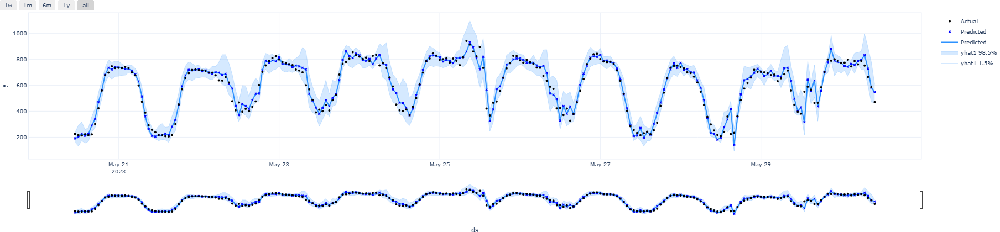

In [422]:
m.highlight_nth_step_ahead_of_each_forecast(1).plot(forecast.iloc[-10 * 24 :])

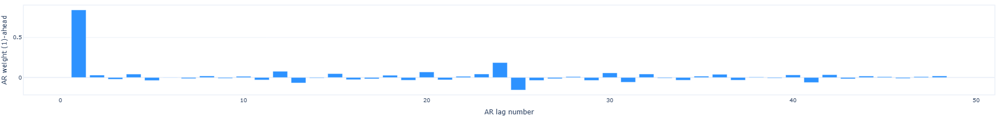

In [414]:
m.plot_parameters(components=["autoregression"])

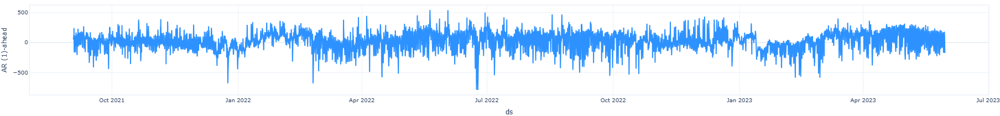

In [415]:
m.plot_components(forecast, components=["autoregression"])

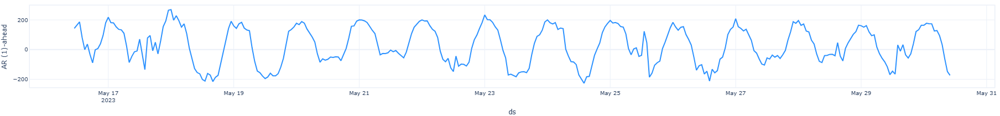

In [416]:
m.plot_components(forecast.tail(14*24), components=["autoregression"])

Hey - a lot better!!

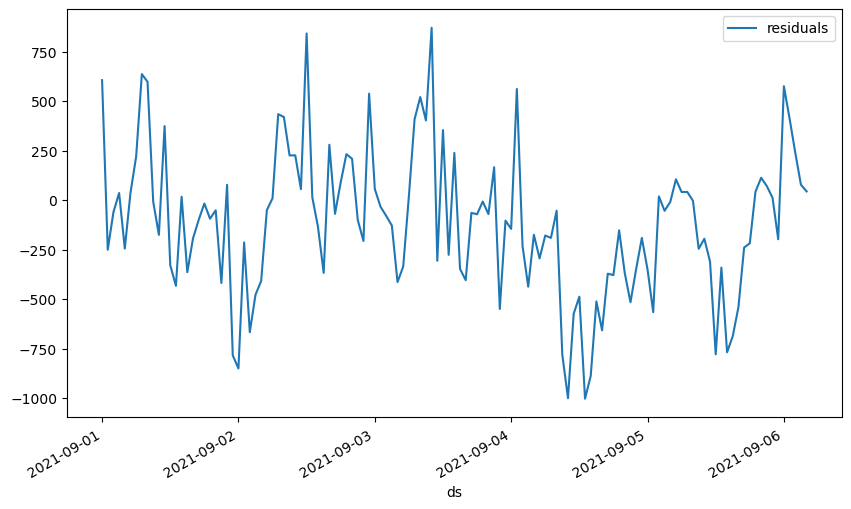

In [417]:
df_residuals = pd.DataFrame({"ds": np_df2["ds"], "residuals": np_df2["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

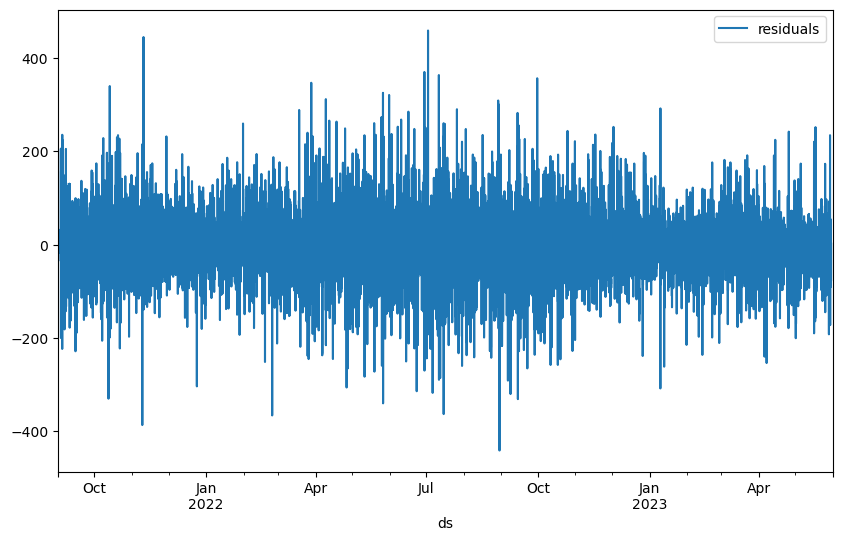

In [418]:
df_residuals = pd.DataFrame({"ds": np_df2.reset_index()["ds"], "residuals": np_df2.reset_index()["y"] - forecast["yhat1"]})
fig = df_residuals.plot(x="ds", y="residuals", figsize=(10, 6))

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\665517487.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




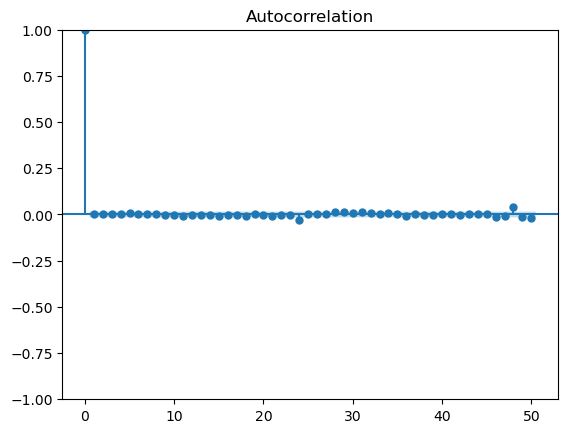

In [419]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=50, )

WARNING - (py.warnings._showwarnmsg) - C:\Users\mskel\AppData\Local\Temp\ipykernel_7464\3167698711.py:3: FutureWarning:

In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.




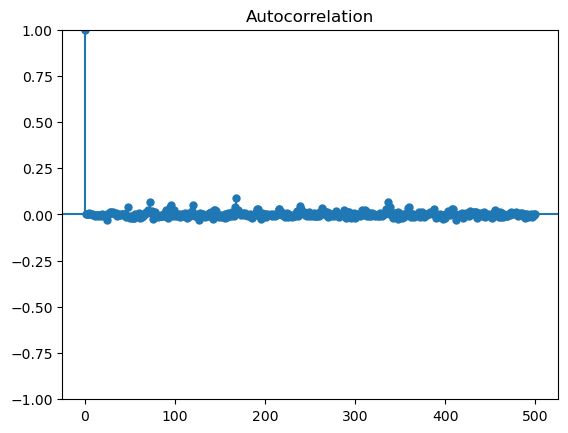

In [420]:
from statsmodels.graphics.tsaplots import plot_acf

df_residuals = df_residuals[~df_residuals.isna().any(1)]

plt = plot_acf(df_residuals["residuals"], lags=500, )